# <ins>**IBM COURSE - APPLIED DATA SCIENCE CAPSTONE PROJECT - THE BATTLE OF NEIGHBOURHOODS**</ins>

## **Background**

**Author:** Arne van den Bosch<br>
**Date  :** 4/3/2021<br>

This notebook has been made as part of the course "IBM Data Science Professional Certificate", which is an introductory course to the field of Data Science. The course consists of 10 modules that cover a variety of aspects of the data science field, including Data Science methodologies, SQL, analysing and visualizing data, machine learning models, etc. As from module 4, the participants start learning the basics of programming in Python. This report is part of a final assignment of the course in which the participants apply the learned theory in practice by coming up with a self-chosen project. As part of the project, geospatial data should be obtained using the Foursquare API. Foursquare is a technology company focused on location data, which is used for apps such as Uber, Apple's Maps, Twitter and a variety of other well known organisations. Via their website, it is for instance possible to look for venues, such as restaurants or shopping facilities in a chosen area and obtain information about those venues, such as customer reviews, photos and a description of the venue itself. Here is an example of a sandwich restaurant in the city of Utrecht in the Netherlands ([link](https://foursquare.com/v/bigoli/4b698feef964a52073a72be3)).<br>

More information about this course can be found on Coursera ([link](https://www.coursera.org/professional-certificates/ibm-data-science)).

## **Introduction / Business Problem**

**Prologue for the Business Problem** <br>
In may 2019 I moved from the upper north of the Netherlands to the province Utrecht, which is one of the 12 provinces in the Netherlands. House prices in the area where I used to live up north of the country were a lot lower than house prices in Utrecht, which is the fourth largest city in the Netherlands. Finding a new place for a reasonable price and with a variety of venues nearby was challenging. Data science skills to gather and to study data would have come in handy during that time. Recently I came across a news article that claimed that house prices in the past 20 years have not risen as fast as in the past quarter. There is a great shortage of houses in the Netherlands, whilst the demand for it keeps rising, driving up the house prices further. Whilst people that like to purchase their first house have great difficulty finding a place that they can afford, it is a lucrative business for professional and private real estate investors, who purchase and resell properties. The situation of moving from a 'cheaper' area to a more 'expensive' area and the challenges that came with finding a place for a reasonable price has given me the inspiration for the self-chosen project for the final assignment of the IBM Data Science course on Coursera. I will further clarify the business problem for the self-chosen project below. <br>

**The Business Problem:**<br>
For this assignment, let's assume a fictional situation in which I am working for a real estate investment agency. This agency has successfully purchased and resold houses in the larger cities in the Netherlands, such as Amsterdam, Rotterdam and The Hague. However - the agency wants to expand its activities to the fourth largest city in the Netherlands as well, which is Utrecht. The agency gives me the assignment to examine potential interesting areas for purchasing and reselling properties. The term 'interesting area' means: areas that have high potential for a good return on investment, so a good profit will be obtained from it when reselling the property. <br>

I think the specified challenge gives a great opportunity to combine a large variety of freely available data on the internet with the Foursquare geospatial data as required by the assignment. I would like to note that many factors can be taken into consideration for determining the 'sweet spots' in terms of potential interesting areas to invest in properties. For this assignment however, I am going to assume the following factors as being important for potential areas of interest:
* House prices over the past 5 years have a stable increasing trend in the area of interest;
* Ideally the house price is currently reasonably low, but has a historical trend that indicates that house prices in that area will rise further in the comming future. 
* There is a variety of venues nearby, such as supermarkets, restaurants, shopping malls, etc. 
* Some additional factors that can be beneficial:
 - Low crime rates / nuisance figures;
 - Low energy consumption;
 - Low number of people using employment allowance;
 - High number of organisations nearby (employment opportunities)

## **Description of the data**

The data used to find answers to the business problem come from different sources, which are:
1. House prices per square meters per municipality in the Netherlands, as Excel file from the website **"Huizenzoeker.nl"** ([link](https://www.huizenzoeker.nl/woningmarkt/download/woningmarkt-gemeenten.xls?d=20210205)).
2. GEOJSON file with geospatial data for each municipality in the Netherlands from website **"hub.arcgis.com"** ([link](https://hub.arcgis.com/datasets/gelderland::grenzen-gemeenten-in-nederland/geoservice?geometry=-28.249%2C49.740%2C38.877%2C54.458)).
3. Venue names, categories and location coordinates are obtained by using the **Foursquare API**. A description of Foursquare was given at the top of this notebook under the heading "Background".
4. Variety of municipality related data (i.e. crime rates, unemployment figures, etc) from the **Dutch Central Bureau of Statistics (CBS for short)** using their **API and python library "cbsodata"** ([link](https://opendata.cbs.nl/statline/portal.html?_la=nl&_catalog=CBS&tableId=84286NED&_theme=235)).

**Data source 1: Huizenzoeker.nl:**<br>
This website has an Excel file containing the total average house prices, median house prices, average house prices per square meter and the number of houses for sale. The link for this Excel file is given at point '1' at the top of this chapter. For this assignment we will use the average house price per square meter to study the house price trends over the past years. This average house price per square meters will also be plotted on choropleth maps for each of the 26 municipalities of Utrecht.

The dataset with house-prices was obtained by using the pandas library's "read_excel()" function. Because the dataset was sufficiently complete and clean there was not a lot of pre-processing and data cleansing required in order to make it useful for further analysis.

In context of the business problem this data will help in finding the municipalities that have had increasing and stable house price increases over the past few years.

**Data source 2: hub.arcgis.com:**<br>
The GEOJSON file is used to obtain the polygon coordinates of the municipalities in the province of Utrecht. Utrecht has 26 municipalities at the moment. In order to plot the shapes of those municipalities on a choropleth map, we will use the 'geopandas' library. This library has a 'gpd.read_file()' function, which allows a GEOJSON file to be retrieved from the internet. The function puts the data in a geopandas-dataframe. The data is filtered for municipalities in the province Utrecht only and is merged with the dataset of Data Source 1. The merged dataframe allows house prices per municipality to be visualized in a choropleth map.

**Data source 3: Foursquare API:**<br>
As requested by the assignment, Foursquare data will be used to obtain venue information, such as location and venue categories (i.e. restaurants, supermarkets, drug store, cafes, monuments, etc) for each of the 26 municipalities. A function will be specified in Python in order to obtain venues in a 5km radius from the centre points of the 26 municipalities. A data frame will be created in order to show the top 10 most common venues. After that, a non-supervised algorithm - the k-means algorithm - will be used to divide the dataset into clusters based on the geographical coordinates of the venues. The clusters are formed based on how near the venues are to each other. The clusters are shown on a folium choropleth map and for each cluster a bar plot is made in order to study the results and examine the distinguishing characteristics of each cluster.

In context of the business problem, the Foursquare venue data will help determine potential popular areas to live. Areas with a variety of venues in the vicinity are generally more popular than places that are remote.

**Data source 4: Dutch Central Bureau of Statistics (CBS for short):** <br>
When looking for freely available data on the internet about the Netherlands there is a great chance that you will en up on the website "opendata.cbs.nl". CBS was founded in 1899 by the government with the task to collect, process and to publish statistics that would be freely available to society. At the end of the 19th century there was an increase in the amount of social malpractices caused by the large-scale industrialisation process. The government saw the establishment of CBS as a solution to this problem. By providing publicly available statistics social inequalities would be reduced and ministries would use reliable and accurate data. Over the years CBS has grown into a modern, innovative organisation and has a vast database with statistics about a large variety of subjects. More information about the CBS can be found on their website ([Link to CBS](https://www.cbs.nl/en-gb/over-ons/organisation)). Their data is published on CBS Open data StatLine ([Link](https://www.cbs.nl/en-gb/over-ons/organisation)) and can be downloaded in a variety of formats, such as csv- or JSON format. Most of the information they publish is also easily accessible for users of Python and R via their API ([Link](https://www.cbs.nl/en-gb/onze-diensten/open-data/statline-as-open-data)).<br>

For the assignment in this notebook I accessed a database containing key figures about municipalities and districts in the Netherlands ([Link](https://opendata.cbs.nl/statline/portal.html?_la=nl&_catalog=CBS&tableId=84286NED&_theme=235)). I used the API of the CBS and the library "cbsodata" to directly obtain the dataset into a pandas dataframe. Then I created a new dataframe which contained the columns of interest and renamed the columns to make it more descriptive. I filtered the dataframe for the 26 municipalities in province Utrecht and examined the quality and completeness of the data. It turned out that on the level of municipalities, the dataset I obtained had no missing data. I turned some columns with total counts into relative figures by dividing the totals by the number of inhabiants in the municipality and multiplying the result by 100.000, such that the figures for those variables could be compared between different municipalities. The dataframe was then merged with the dataframe of "Data source 2" mentioned above in order to be able to put the figures on choropleth maps. Finally I plotted the figures in both choropleth maps, complemented by bar charts that show the figures in a descending order. <br>

The key figures I chose from the dataset for further analysis are:
1. Average Electricity Consumption in kWh
2. Average Gas Consumption in m3
3. Average Income per inhabitant x 1000Euro
4. Percentage of households with low income
5. Number of people using welfare allowance
6. Number of people using unemployment allowance
7. Number of thefts from house or barn
8. Number of registered cases of destructive behaviour
9. Number of companies and organisations<br>

Variable number 5, 6, 7 and 8 were turned into relative figures by dividing the amount by the number of inhabitants of the municipality and multiplying the result by 100.000 for the purpose of being able to compare the figures of different municipalities to each other. <br>

Variable number 1 and 2 in the list above may give insight about for instance areas that have newly build homes, which consume less energy or where solar panels, district heating or thermal storage systems may be present, thereby reducing electricity/gas consumption. Energy efficient homes are becoming more and more popular in the Netherlands. Variable 3, 4, 5 and 6 could give us some information about the most dominant social classes in each municipality, which could be interesting as it could help indicate whether a particular area would be more or less suitable for investing in real estate. For instance, areas where people have high average income and where less people are using an unemployment allowance are preferred over areas that have low income and higher percentages of people using unemployment allowances. Variable 7, 8 and 9 can indicate how save a particular municipality is and variable number 10 may be interesting from the perspective of employment opportunities. The assumption is then that areas with more companies/organisations would also have more job opportunities.

## **Methodology**

In this section we will collect the data from the sources described in previous section. <br>
The data will be pre-processed and made fit for purpose in order to make visualizations and perform further analysis. 

### <ins> **Part 1: Obtaining average house prices per m2 and examinig the trends over the past few years for each of the 26 municipalities in province Utrecht** </ins>

In part 1 we will obtain the house price data from the website "Huizenzoeker.nl". The data is available in Excel file format from the website and will be retrieved using the pandas library and its "read_excel()" function.

#### **Importing the required libraries**

In [1]:
import numpy as np                        # library for vectorized computation
import pandas as pd                       # library to process data as dataframes
import matplotlib.pyplot as plt           # library for creating static, animated, and interactive visualizations in Python.
import seaborn as sns                     # libary for visualizing data in different types of charts, such as line charts, bar charts, etc.
import cbsodata                           # Library to use the API of the Dutch Central Bureau of Statistics (CBS for short)
import geopandas as gpd                   # for handling geospacial data
from datetime import datetime             # for manipulating dates

# backend for rendering plots within the browser
%matplotlib inline 

#### **Obtaining the average house prices per square meter from Dutch website "huizenzoeker.nl" and put data in pandas dataframe**

In [2]:
# Create URL to Excel file (alternatively this can be a filepath)
url = 'https://www.huizenzoeker.nl/woningmarkt/download/woningmarkt-gemeenten.xls?d=20210205'

# Load the first sheet of the Excel file into a data frame
Avg_House_price_per_m2_Raw_df = pd.read_excel(url, sheet_name='Gem. vraagprijs per m2', header=0)

# View the first five rows
Avg_House_price_per_m2_Raw_df.head(5)

*** No CODEPAGE record, no encoding_override: will use 'ascii'
*** No CODEPAGE record, no encoding_override: will use 'ascii'
*** No CODEPAGE record, no encoding_override: will use 'ascii'
*** No CODEPAGE record, no encoding_override: will use 'ascii'
*** No CODEPAGE record, no encoding_override: will use 'ascii'


,Gemeente,Sep 2008,Okt 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,Mrt 2009,Apr 2009,Mei 2009,...,Mei 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Okt 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,'s-Gravenhage,2251,2263,2289,2270,2271,2278,2295,2308,2313,...,3433,3469,3476,3481,3495,3490,3517,3543,3595,3612
1,'s-Hertogenbosch,2533,2540,2544,2535,2535,2520,2509,2506,2514,...,3236,3213,3259,3219,3251,3315,3348,3403,3436,3426
2,Aa en Hunze,2404,2408,2418,2422,2418,2421,2373,2343,2331,...,2331,2370,2338,2402,2438,2431,2451,2374,2460,2555
3,Aalburg,2788,2874,2859,2878,2843,2792,2657,2603,2612,...,2745,2768,2734,2731,2730,2717,2725,2718,2820,2937
4,Aalsmeer,3087,3096,3090,3075,3046,3048,3033,3023,3034,...,3814,3870,3928,3987,4057,4001,3942,3973,3996,4082


#### **Checking the data types of the columns and presence of missing data**

In [3]:
Avg_House_price_per_m2_Raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 456 entries, 0 to 455
Columns: 151 entries, Gemeente to Feb 2021
dtypes: int64(150), object(1)
memory usage: 538.1+ KB


Column "Gemeente" is of type 'object' and the rest of the columns are of type 'int64'. <br>
There is no record of null values.

#### **Exporting the dataframe to Excel to do a quick visual scan through the dataset**

The "info()" function showed that there were no null-values. However - in some datasets, missing data is replaced by some other record, for instance by a particular value '99999', '0' or some other value or a symbol (i.e. '-'). <br>
To be sure if missing data is replaced by a particular number or symbol we will export the data to Excel and scan through the dataset.

In [4]:
Avg_House_price_per_m2_Raw_df.to_excel('Avg_House_price_per_m2_Raw_df.xlsx')

After scanning through the dataset, it is apparent that for records where no data is available the values '0' are entered.

#### **Translating and changing some column names from Dutch to English**

In [5]:
# Rename column names
Avg_House_price_per_m2_Raw_df.rename(columns={"Gemeente": "Municipality"},inplace = True)

# Replace some of the words in the column names
Avg_House_price_per_m2_Raw_df.columns = Avg_House_price_per_m2_Raw_df.columns.map(lambda x : x.replace("Okt", "Oct").replace("Mrt", "Mar").replace("Mei","May")) 

# Show the top 2 rows of the dataframe
Avg_House_price_per_m2_Raw_df.head(2)

,Municipality,Sep 2008,Oct 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,Mar 2009,Apr 2009,May 2009,...,May 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,'s-Gravenhage,2251,2263,2289,2270,2271,2278,2295,2308,2313,...,3433,3469,3476,3481,3495,3490,3517,3543,3595,3612
1,'s-Hertogenbosch,2533,2540,2544,2535,2535,2520,2509,2506,2514,...,3236,3213,3259,3219,3251,3315,3348,3403,3436,3426


#### **Substituting 3 municipalities which became one municipality in 2019, thereby taking an average price from the 3 municipalities**

Leerdam, Vianen and Zederik have been separate municipalities prior to the 1st of januari 2019, but became one municipality after 2019. <br>
The new munciaplity that was compiled out of the 3 mentioned muncipalities is called "Vijfheerenlanden". <br>
The dataset still has the 3 older separate municipalities, but we are going to merge those into one, thereby taking an average price for the 3 municipalities.<br>
I came across this problem later in this notebook when merging a dataset with geospatial data with the dataframe we are working on here. <br>
The dataset with geospatial data does not have the older 3 municipalities 'Leerdam','Vianen' and 'Zederik', but includes the new municipality 'Vijfheerenlanden'. <br>
In this step we will prevent this problem from happenining later on in this notebook.

In [6]:
# Create new dataframe with a selection of the 3 municipalities, that became one municipality in 2019
Dataframe_LeerdamVianenZederik_df = Avg_House_price_per_m2_Raw_df[Avg_House_price_per_m2_Raw_df.Municipality.isin(['Leerdam','Vianen','Zederik'])]

# Transpose the dataframe, so the rows become columns and the values are put below the columns. This makes it easier to take the mean of the 3 columns in the next step.
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df.set_index('Municipality').transpose()

# Create an extra column "Vijfheerenlanden", in which the average values is put calculated from the other 3 columns
Dataframe_LeerdamVianenZederik_df['Vijfheerenlanden'] = Dataframe_LeerdamVianenZederik_df[['Zederik','Vianen','Leerdam']].mean(axis=1).round(decimals=0).astype(np.int64)

# Transpose the dataframe back to the initial format
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df.transpose().reset_index(drop = False)

# Filter the tansposed dataframe for the municipality "Vijfheerenlanden", thereby excluding the old municipalities 'Leerdam','Vianen' and 'Zederik'
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df [Dataframe_LeerdamVianenZederik_df.Municipality.isin(['Vijfheerenlanden'])]

# Add the dataframe with the average house price for municipality "Vijfheerenlanden" back to the original dataframe
Avg_House_price_per_m2_Raw_df = Avg_House_price_per_m2_Raw_df.append(Dataframe_LeerdamVianenZederik_df, ignore_index = True, sort = False)

# Remove the rows of the municipalities 'Leerdam','Vianen' and 'Zederik', which have been replaced by the row 'Vijfheerenlanden'
Avg_House_price_per_m2_Raw_df.drop(Avg_House_price_per_m2_Raw_df[Avg_House_price_per_m2_Raw_df['Municipality'] == 'Leerdam'].index, inplace =True)
Avg_House_price_per_m2_Raw_df.drop(Avg_House_price_per_m2_Raw_df[Avg_House_price_per_m2_Raw_df['Municipality'] == 'Vianen'].index, inplace =True)
Avg_House_price_per_m2_Raw_df.drop(Avg_House_price_per_m2_Raw_df[Avg_House_price_per_m2_Raw_df['Municipality'] == 'Zederik'].index, inplace =True)

# Sort the values in descending order by the last column of the dataframe, which is "Feb 2021"
Avg_House_price_per_m2_Raw_df.sort_values(by=['Feb 2021'], ascending = False, inplace = True)

# Reset the index
Avg_House_price_per_m2_Raw_df.reset_index(drop = True, inplace = True)

# Make a copy of the dataframe that was just created
Avg_House_price_per_m2_NL_df = Avg_House_price_per_m2_Raw_df.copy()

# Show the top 10 rows of the dataframe
Avg_House_price_per_m2_NL_df.head(10)

,Municipality,Sep 2008,Oct 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,Mar 2009,Apr 2009,May 2009,...,May 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,Laren,5336,5272,5208,5120,5062,4990,4980,4985,4969,...,6458,5930,5705,5715,5806,5794,5920,6064,6929,7104
1,Amsterdam,3634,3651,3669,3666,3647,3627,3619,3628,3634,...,5948,6016,6016,6062,6080,6031,6087,6139,6200,6188
2,Blaricum,5711,5582,5495,5255,5021,4942,5093,5278,5321,...,5473,5947,6063,6091,6283,6095,6124,6235,6245,6013
3,Wassenaar,4668,4715,4715,4639,4529,4447,4443,4443,4456,...,5398,5605,5742,5791,5763,5807,5819,5857,6000,5955
4,Bloemendaal,5259,5235,5198,5103,5104,5145,5057,4964,4938,...,5998,5953,6045,6270,6163,6225,6179,5958,5688,5635
5,Wijdemeren,4173,4164,4156,4172,4106,3901,3847,3841,3848,...,5147,5035,5045,5074,5238,5372,5450,5425,5551,5544
6,Ouder-Amstel,3019,3086,3258,3280,3202,3238,3187,3217,3315,...,4935,4926,4838,4859,4879,4982,5127,5110,5377,5543
7,Bergen (NH),4261,4268,4275,4224,4186,4182,4181,4173,4188,...,5122,5072,5071,5046,5112,5167,5265,5327,5436,5288
8,Noordwijk,3538,3548,3570,3517,3517,3576,3627,3576,3559,...,5181,5136,5091,5001,4955,5069,5151,5078,5132,5127
9,Amstelveen,3108,3118,3170,3137,3110,3104,3078,3043,3018,...,4913,4864,4820,4821,4846,4856,4928,4954,4988,5017


#### **Importing libraries for obtaining geospatial data from a GEOSJON file**

In [7]:
import geopandas as gpd                   # for handling geospacial data and creating maps
from datetime import datetime             # for manipulating dates
import folium                             # a library for creating interactive maps

#### **Obtaining GEOJSON file with coordinates of municipalities in the Netherlands and read into pandas dataframe using the Geopandas library**

In [8]:
URL_GEOJSON_file ='https://opendata.arcgis.com/datasets/47c1676d21974b58857a92251adc328b_5.geojson' #From the website: https://hub.arcgis.com/datasets/gelderland::grenzen-gemeenten-in-nederland/geoservice?geometry=-28.249%2C49.740%2C38.877%2C54.458
Geo_Coord_Municipalities_Raw_df = gpd.read_file(URL_GEOJSON_file)
Geo_Coord_Municipalities_Raw_df.head(3)

,objectid,gemnaam,gemcode,gemnr,xcoord,ycoord,arron,arron_nm,corop,corop_nm,...,stadgew_nm,veilig,veilig_nm,wgr,wgr_nm,adressen,inw_t,st_areashape,st_lengthshape,geometry
0,1,Appingedam,0003,3,252213,593277,None,None,None,None,...,None,None,None,None,None,6412,11795,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ..."
1,2,Delfzijl,0010,10,258300,589658,None,None,None,None,...,None,None,None,None,None,13197,24870,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ..."
2,3,Groningen,0014,14,234232,581102,None,None,None,None,...,None,None,None,None,None,126551,229970,1.978564e+08,98196.660775,"POLYGON ((6.47634 53.23591, 6.47610 53.23537, ..."


**Remark:**<br>
Using the "type()" function below, we see that above dataframe is a 'geopandas' dataframe.

In [9]:
type(Geo_Coord_Municipalities_Raw_df)

geopandas.geodataframe.GeoDataFrame

#### **Removing unnecessary columns from the Geopandas dataframe**

In [10]:
Geo_Coord_Municipalities_NL_df = Geo_Coord_Municipalities_Raw_df[['gemnaam','st_areashape','st_lengthshape','geometry']].copy()
Geo_Coord_Municipalities_NL_df.head(2)

,gemnaam,st_areashape,st_lengthshape,geometry
0,Appingedam,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ..."
1,Delfzijl,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ..."


#### **Rename the column 'gemnaam' to 'Municipality' in the Geopandas dataframe**

In [11]:
Geo_Coord_Municipalities_NL_df.rename(columns={"gemnaam": "Municipality"}, inplace = True)
Geo_Coord_Municipalities_NL_df.head(2)

,Municipality,st_areashape,st_lengthshape,geometry
0,Appingedam,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ..."
1,Delfzijl,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ..."


In [12]:
# Creating a copy of the dataframe "Geo_Coord_Municipalities_NL_df"
Geo_Coord_Munic_NL_df = Geo_Coord_Municipalities_NL_df.copy()

#### **Merging the Geopandas dataframe "Avg_House_price_per_m2_NL_df" on the dataframe "Geo_Coord_Munic_NL_df", using the column 'Municipality' in both dataframes**

In [13]:
# Merging 2 dataframes on corresponding column 'Municipality'
Geo_df_avg_house_price_per_m2_NL = pd.merge(Geo_Coord_Munic_NL_df,Avg_House_price_per_m2_NL_df,how = 'left',left_on = 'Municipality', right_on = 'Municipality')
Geo_df_avg_house_price_per_m2_NL.head(5)

,Municipality,st_areashape,st_lengthshape,geometry,Sep 2008,Oct 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,...,May 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,Appingedam,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ...",1735.0,1717.0,1717.0,1768.0,1799.0,1788.0,...,1833.0,1936.0,1931.0,1976.0,1930.0,1934.0,1949.0,1933.0,2042.0,2177.0
1,Delfzijl,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ...",1640.0,1647.0,1665.0,1658.0,1646.0,1649.0,...,1629.0,1678.0,1670.0,1705.0,1766.0,1760.0,1772.0,1855.0,1920.0,1938.0
2,Groningen,1.978564e+08,98196.660775,"POLYGON ((6.47634 53.23591, 6.47610 53.23537, ...",2015.0,2003.0,1999.0,1999.0,1997.0,2001.0,...,2650.0,2653.0,2591.0,2557.0,2624.0,2670.0,2715.0,2734.0,2792.0,2759.0
3,Loppersum,1.119941e+08,64460.648494,"POLYGON ((6.71516 53.37337, 6.71408 53.37282, ...",1691.0,1707.0,1709.0,1741.0,1739.0,1727.0,...,1804.0,1846.0,1811.0,1802.0,1672.0,1682.0,1816.0,1923.0,1918.0,1865.0
4,Almere,1.393973e+08,58860.779608,"POLYGON ((5.16002 52.39639, 5.15684 52.39295, ...",2009.0,2014.0,2019.0,2023.0,2015.0,2010.0,...,2793.0,2811.0,2854.0,2849.0,2883.0,2937.0,2987.0,3043.0,3089.0,3091.0


**Checking the type of the dataframe:**

In [14]:
type(Geo_df_avg_house_price_per_m2_NL)

geopandas.geodataframe.GeoDataFrame

The dataframe is a normal pandas dataframe. We should convert this dataframe to a Geopandas dataframe in order to be able to plot data on a choropleth map.

**Converting the merged dataframe to a Geopandas - dataframe**

In [15]:
from geopandas import GeoDataFrame
Geo_df_avg_house_price_per_m2_NL = GeoDataFrame(Geo_df_avg_house_price_per_m2_NL) # Convert normal pandas dataframe to geopandas dataframe for the Choropleth Map that will be made later in this notebook.
type(Geo_df_avg_house_price_per_m2_NL)

geopandas.geodataframe.GeoDataFrame

#### **Creating a new dataframe in which house prices per m2 for februari 2021 and house price increase for the last 6 years is shown**

<ins>**FOR ALL MUNICIPALITIES IN THE NETHERLANDS**</ins>

**1. Dataframe with house prices per m2 and increase in house prices per m2 for the Netherlands (without lattitude/longitude):**

In [16]:
# Make a new dataframe by copying the desired columns from the dataframe "Geo_df_avg_house_price_per_m2_NL"
Geo_df_avg_house_price_per_m2_NL_Feb_2021 = Geo_df_avg_house_price_per_m2_NL[['Municipality','Feb 2015','Feb 2021','st_areashape','st_lengthshape','geometry']].copy()

# Rename the columns
Geo_df_avg_house_price_per_m2_NL_Feb_2021.rename(columns={"Feb 2015":"House_price_per_m2_Feb_2015","Feb 2021": "House_price_per_m2_Feb_2021"}, inplace = True)

# Calculate the price increase in the past 6 years and insert the result as a new column
New_Column = (Geo_df_avg_house_price_per_m2_NL_Feb_2021['House_price_per_m2_Feb_2021']- Geo_df_avg_house_price_per_m2_NL_Feb_2021['House_price_per_m2_Feb_2015'])
Geo_df_avg_house_price_per_m2_NL_Feb_2021.insert(loc = 3,column = 'House_Price_increase_per_m2_Feb_2015_to_Feb_2021',value = New_Column)

# Remove the columns "House_price_per_m2_Feb_2015", which is not needed anymore
Geo_df_avg_house_price_per_m2_NL_Feb_2021.drop('House_price_per_m2_Feb_2015',axis = 1, inplace = True)

# Show the first 2 rows of the dataframe
Geo_df_avg_house_price_per_m2_NL_Feb_2021.head(2)

,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry
0,Appingedam,2177.0,503.0,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ..."
1,Delfzijl,1938.0,504.0,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ..."


In [17]:
type(Geo_df_avg_house_price_per_m2_NL_Feb_2021)

geopandas.geodataframe.GeoDataFrame

**2. Dataframe with house prices per m2 and increase in house prices per m2 for the Netherlands (including lattitude/longitude):**

Let's add some center points to the dataframe, which comes in handy when we like to add labels to a map.

In [18]:
from shapely.geometry import Point

# Create a copy of the dataframe "Geo_df_avg_house_price_per_m2_NL_Feb_2021"
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord = Geo_df_avg_house_price_per_m2_NL_Feb_2021.copy()

# Add an extra column to the dataframe with the "Center Point" (the lattitude and longitude coordinates of the middle point) using the ".centroid" method.
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Center_point'] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['geometry'].to_crs("EPSG:4326")
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Center_point'] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['geometry'].centroid

# Extract "lattitude" and "longitude" coordinates from the Center Point and add two extra columns containing 
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord["Long"] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Center_point'].map(lambda p: p.x)
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord["Lat"] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Center_point'].map(lambda p: p.y)

# Add extra column "Coordinates" and fill up the column with text in which the coordinates are concatenated
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Coordinates'] = "(" + Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Long'].map(str) + ", " + Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Lat'].map(str) + ")"

# Convert values of column "Coordinates" from type "Str"to type "tuple". This is necessary to be able to use the Coordinates for the Choropleth map.
from ast import literal_eval
Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Coordinates'] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Coordinates'].apply(lambda x: literal_eval(str(x))) 

Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord.head(5)

<ipython-input-18-e412f48181e7>:8: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Center_point'] = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['geometry'].centroid


,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry,Center_point,Long,Lat,Coordinates
0,Appingedam,2177.0,503.0,2.462025e+07,25998.736105,"POLYGON ((6.80518 53.31672, 6.80510 53.31669, ...",POINT (6.84963 53.31709),6.849634,53.317086,"(6.849633600729762, 53.31708587700029)"
1,Delfzijl,1938.0,504.0,1.356711e+08,87605.267135,"POLYGON ((6.78907 53.40235, 6.78721 53.40167, ...",POINT (6.92951 53.32011),6.929508,53.320110,"(6.929507506553045, 53.32010952123877)"
2,Groningen,2759.0,838.0,1.978564e+08,98196.660775,"POLYGON ((6.47634 53.23591, 6.47610 53.23537, ...",POINT (6.62066 53.21863),6.620659,53.218633,"(6.620659225096424, 53.21863257047191)"
3,Loppersum,1865.0,317.0,1.119941e+08,64460.648494,"POLYGON ((6.71516 53.37337, 6.71408 53.37282, ...",POINT (6.72815 53.34070),6.728147,53.340698,"(6.728147238081251, 53.340697641881924)"
4,Almere,3091.0,1156.0,1.393973e+08,58860.779608,"POLYGON ((5.16002 52.39639, 5.15684 52.39295, ...",POINT (5.24692 52.36694),5.246920,52.366940,"(5.246919556937503, 52.36693975508572)"


<ins>**FOR ALL MUNICIPALITIES IN PROVINCE UTRECHT ONLY**</ins>

**Create a list of municipalities in Utrecht. The list will be used to filter the dataframes for municipalities in Utrecht**

In [19]:
# Creating a list of the 26 municipalities in Utrecht 
List_Municipalities_in_Utrecht_Province = ['Amersfoort', 'Baarn', 'Bunnik', 'Bunschoten', 'De Bilt', 'De Ronde Venen', 'Eemnes', 
                                           'Houten', 'IJsselstein', 'Leusden', 'Lopik', 'Montfoort', 
                                           'Nieuwegein', 'Oudewater', 'Renswoude', 'Rhenen', 'Soest', 
                                           'Stichtse Vecht', 'Utrecht', 'Utrechtse Heuvelrug', 'Veenendaal', 
                                           'Wijk bij Duurstede', 'Woerden', 'Woudenberg', 'Zeist', 'Vijfheerenlanden']

**1. Dataframe with house prices per m2 and increase in house prices per m2 for Utrecht (without lattitude/longitude):**

The dataframes for the Netherlands "Geo_df_avg_house_price_per_m2_NL_Feb_2021" was created above.<br>
Below we just use above list of municipalities in Utrecht to select municipalities in Utrecht.

In [20]:
# Creating a new dataframe by copying all rows with municipalities in Utrecht using the list with municialities in Utrecht.
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021 = Geo_df_avg_house_price_per_m2_NL_Feb_2021[Geo_df_avg_house_price_per_m2_NL_Feb_2021['Municipality'].isin(List_Municipalities_in_Utrecht_Province)].copy()

# Sort the dataframe in descending order based on the last column of the dataframe
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.sort_values(by=['House_price_per_m2_Feb_2021'], ascending = False, inplace = True)

# Drop and reset the index numbering
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.reset_index(drop = True, inplace = True)

# Show the dataframe
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.head(2)

,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry
0,Baarn,4707.0,1649.0,3.302635e+07,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ..."
1,De Bilt,4486.0,1165.0,6.710147e+07,43218.826211,"POLYGON ((5.11861 52.17244, 5.11867 52.17230, ..."


In [21]:
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.shape

(26, 6)

**2. Dataframe with house prices per m2 and increase in house prices per m2 for Utrecht (including lattitude/longitude):**

The dataframes for the Netherlands "Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord" was created above.<br>
Below we just use above list of municipalities in Utrecht to select municipalities in Utrecht.

In [22]:
# Creating a new dataframe by copying all rows with municipalities in Utrecht using the list with municialities in Utrecht.
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord[Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['Municipality'].isin(List_Municipalities_in_Utrecht_Province)].copy()

# Sort the dataframe in descending order based on the last column of the dataframe
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.sort_values(by=['House_price_per_m2_Feb_2021'], ascending = False, inplace = True)

# Drop and reset the index numbering
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.reset_index(drop = True, inplace = True)

# Show the dataframe
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.head(2)

,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry,Center_point,Long,Lat,Coordinates
0,Baarn,4707.0,1649.0,3.302635e+07,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ...",POINT (5.26417 52.20385),5.264172,52.203848,"(5.264172266197837, 52.203847837423176)"
1,De Bilt,4486.0,1165.0,6.710147e+07,43218.826211,"POLYGON ((5.11861 52.17244, 5.11867 52.17230, ...",POINT (5.17433 52.14173),5.174335,52.141734,"(5.174334940770484, 52.14173369932546)"


In [34]:
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.to_excel('Coordinates.xlsx')

#### **Plotting 2 choropleth maps and corresponding bar charts that show the average house price per m2 for each municipality in the Netherlands and in Utrecht respectively**

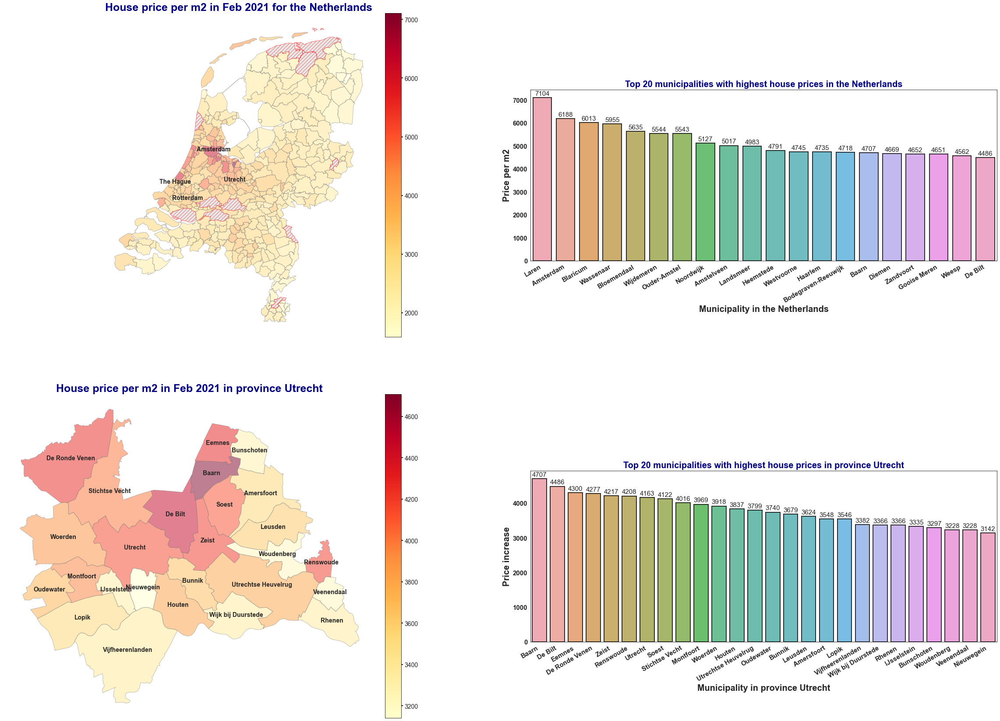

In [78]:
# Define the size of the total figure, including the Choropleth Map and 2 Bar Charts
fig = plt.figure(figsize=(45,23))

# ===================================================================================================================================================    

# CHOROPLETH MAP WITH HOUSE PRICE PER M2 FOR THE NETHERLANDS

# Specify the grid and and postion for the Choropleth Map
ax1 = plt.subplot2grid((10,3),(0,0), colspan = 2, rowspan = 5)

# add a title and annotation
ax1.set_title('House price per m2 in Feb 2021 for the Netherlands', fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord.plot(column='House_price_per_m2_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax1, edgecolor='.5',alpha = 0.5, 
                                                           missing_kwds={'color':'lightgrey','edgecolor':'red','hatch':'///','label':'Missing values'})

# remove the axis around the Choropleth Map
ax.axis('off')

# set to min and max of data for the colorbar
vmin, vmax = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min(), Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
# for idx, row in Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord.iterrows():
#        plt.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')

ax1.annotate(text='Utrecht',xy = (5.227662, 52.092777),horizontalalignment = 'center',fontsize=14,weight = 'bold')
ax1.annotate(text='Amsterdam',xy=(4.905045, 52.380916),horizontalalignment = 'center',fontsize=14,weight = 'bold')
ax1.annotate(text='Rotterdam',xy=(4.499745, 51.918462),horizontalalignment = 'center',fontsize=14,weight = 'bold')
ax1.annotate(text='The Hague',xy=(4.304373, 52.070156),horizontalalignment = 'center',fontsize=14,weight = 'bold')

# ===================================================================================================================================================    
        
# CHOROPLETH MAP WITH HOUSE PRICE PER M2 FOR UTRECHT

# Specify the grid and and postion for the Choropleth Map
ax2 = plt.subplot2grid((10,3),(5,0), colspan = 2, rowspan = 5)

# add a title and annotation
ax2.set_title('House price per m2 in Feb 2021 in province Utrecht', fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(column='House_price_per_m2_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax2, edgecolor='.5',alpha = 0.5)

# remove the axis around the Choropleth Map
ax.axis('off')

# set to min and max of data for the colorbar
vmin, vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min(), Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
for idx, row in Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.iterrows():
        plt.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')       
        
# ===================================================================================================================================================    

# BAR CHART - SHOWING THE AVERAGE HOUSE PRICE PER M2 FOR THE NETHERLANDS

# Specify the grid and and postion for the bar chart
ax3 = plt.subplot2grid((10,3), (1,2), colspan = 1, rowspan = 3)

# Specify the required dataframe to plot price per m2 for each municipality
df_NL_price_2021 = Geo_df_avg_house_price_per_m2_NL_Feb_2021_w_coord[['Municipality','House_price_per_m2_Feb_2021']].set_index('Municipality').sort_values(by=['House_price_per_m2_Feb_2021'], ascending = False).head(20)

# Create Bar Chart with for the specified dataframe
BarplotFigure1 = sns.barplot(df_NL_price_2021.index,df_NL_price_2021['House_price_per_m2_Feb_2021'].values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax3)

# Adding numbers on top of each bar
for p in BarplotFigure1.patches:
     BarplotFigure1.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
# Adding/formatting chart elements
ax3.set_title('Top 20 municipalities with highest house prices in the Netherlands',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax3.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax3.get_yticklabels(),fontsize = 15, fontweight = 'bold')
plt.xlabel('Municipality in the Netherlands',fontsize=20, weight = 'bold')
plt.ylabel('Price per m2',fontsize=20, weight = 'bold')
#plt.ylim(0,6000)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()

# ===================================================================================================================================================  

# BAR CHART - SHOWING THE AVERAGE HOUSE PRICE PER M2 FOR UTRECHT

# Specify the grid and and postion for the bar chart
ax4 = plt.subplot2grid((10, 3), (6, 2), colspan = 1, rowspan = 3)

# Specify the required dataframe to plot price per m2 for each municipality
df_Utr_price_2021 = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord[['Municipality','House_price_per_m2_Feb_2021']].set_index('Municipality').sort_values(by=['House_price_per_m2_Feb_2021'], ascending = False)

# Create Bar Chart with for the specified dataframe
BarplotFigure2 = sns.barplot(df_Utr_price_2021.index,df_Utr_price_2021['House_price_per_m2_Feb_2021'].values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax4)

# Adding numbers on top of each bar
for p in BarplotFigure2.patches:
    BarplotFigure2.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
    # Adding/formatting chart elements
ax4.set_title('Top 20 municipalities with highest house prices in province Utrecht',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax4.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax4.get_yticklabels(),fontsize = 15, fontweight = 'bold')
plt.xlabel('Municipality in province Utrecht',fontsize=20, weight = 'bold')
plt.ylabel('Price increase',fontsize=20, weight = 'bold')
#plt.ylim(0,3000)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()
fig.tight_layout()
    
plt.show()

#### **Observations:**

The choropleth map of the Netherlands on the upper left hand side clearly indicates that Utrecht is one of the areas with the highest average house prices in the Netherlands. From the bar chart on the upper right hand side it is clear that municipalities in Utrecht are not in the top 10 when considering all the municipalities in the Netherlands. The highest house prices for Utrecht are in municipality Baarn, followed by the Bilt. On the list of places with highest house prices in the Netherlands, Baarn is on place 15 and De Bilt is on place 20.

#### **Plotting the trends of house prices over the years for each municipality in Utrecht**

**Show the dataframe that has been obtained earlier in this notebook**

In [86]:
Avg_House_price_per_m2_NL_df.head(2)

,Municipality,Sep 2008,Oct 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,Mar 2009,Apr 2009,May 2009,...,May 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,Laren,5336,5272,5208,5120,5062,4990,4980,4985,4969,...,6458,5930,5705,5715,5806,5794,5920,6064,6929,7104
1,Amsterdam,3634,3651,3669,3666,3647,3627,3619,3628,3634,...,5948,6016,6016,6062,6080,6031,6087,6139,6200,6188


**Create a new dataframe from the above dataframe by selecting the 26 municipalities of Utrecht using a list**

In [90]:
# Creating a list of the 26 municipalities in Utrecht 
List_Municipalities_in_Utrecht_Province = ['Amersfoort', 'Baarn', 'Bunnik', 'Bunschoten', 'De Bilt', 'De Ronde Venen', 'Eemnes', 
                                           'Houten', 'IJsselstein', 'Leusden', 'Lopik', 'Montfoort', 
                                           'Nieuwegein', 'Oudewater', 'Renswoude', 'Rhenen', 'Soest', 
                                           'Stichtse Vecht', 'Utrecht', 'Utrechtse Heuvelrug', 'Veenendaal', 
                                           'Wijk bij Duurstede', 'Woerden', 'Woudenberg', 'Zeist', 'Vijfheerenlanden']

# Creating a new dataframe by copying all rows with municipalities in Utrecht using the list with municialities in Utrecht.
Avg_House_price_per_m2_Utrecht_df = Avg_House_price_per_m2_NL_df[Avg_House_price_per_m2_NL_df['Municipality'].isin(List_Municipalities_in_Utrecht_Province)].copy()
Avg_House_price_per_m2_Utrecht_df.reset_index(drop = True, inplace = True)
Avg_House_price_per_m2_Utrecht_df.head(2)


,Municipality,Sep 2008,Oct 2008,Nov 2008,Dec 2008,Jan 2009,Feb 2009,Mar 2009,Apr 2009,May 2009,...,May 2020,Jun 2020,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021
0,Baarn,3448,3436,3443,3459,3443,3403,3395,3344,3323,...,4455,4436,4307,4253,4301,4562,4670,4483,4659,4707
1,De Bilt,3450,3504,3490,3475,3449,3398,3397,3394,3369,...,4380,4340,4339,4360,4430,4453,4411,4401,4469,4486


In [91]:
Avg_House_price_per_m2_Utrecht_df.shape

(26, 151)

The amount of municipalities is 26, so that corresponds with the amount of municipalities in Utrecht.

**Transpose the dataframe for the purpose of plotting it in a line-chart a little later in this notebook**

In [93]:
# Transpose the dataframe and set Municipality as index column
Avg_House_price_per_m2_Utrecht_df_transposed = Avg_House_price_per_m2_Utrecht_df.set_index('Municipality').transpose()

# Reset the index
Avg_House_price_per_m2_Utrecht_df_transposed.reset_index(drop = False, inplace = True)
Avg_House_price_per_m2_Utrecht_df_transposed = Avg_House_price_per_m2_Utrecht_df_transposed.rename_axis(None, axis = 1)
Avg_House_price_per_m2_Utrecht_df_transposed.rename(columns={"index": "Month and year"},inplace = True)

# Show the top 5 rows of the dataframe
Avg_House_price_per_m2_Utrecht_df_transposed.head(5)

,Month and year,Baarn,De Bilt,Eemnes,De Ronde Venen,Zeist,Renswoude,Utrecht,Soest,Stichtse Vecht,...,Amersfoort,Lopik,Vijfheerenlanden,Wijk bij Duurstede,Rhenen,IJsselstein,Bunschoten,Veenendaal,Woudenberg,Nieuwegein
0,Sep 2008,3448,3450,3347,3475,3353,3048,2837,3147,0,...,2511,2690,2727,2818,2956,2847,2698,2650,2714,2274
1,Oct 2008,3436,3504,3389,3503,3399,2979,2839,3148,0,...,2520,2726,2777,2901,3001,2811,2628,2658,2771,2289
2,Nov 2008,3443,3490,3312,3502,3382,3026,2863,3119,0,...,2528,2762,2809,2933,3069,2780,2517,2643,2781,2268
3,Dec 2008,3459,3475,3194,3485,3369,3003,2866,3126,0,...,2529,2801,2828,2970,3052,2835,2531,2633,2779,2272
4,Jan 2009,3443,3449,3200,3524,3357,2998,2873,3096,0,...,2519,2808,2770,3015,3049,2820,2565,2626,2780,2289


**Remark:**<br>
Above dataframe will be used to loop through in order to make linechart-subplots showing the house-price trends over the years for each municipality.

**Show a dataframe that was created earlier in this notebook**

In [94]:
Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.head(4)

,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry
0,Baarn,4707.0,1649.0,3.302635e+07,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ..."
1,De Bilt,4486.0,1165.0,6.710147e+07,43218.826211,"POLYGON ((5.11861 52.17244, 5.11867 52.17230, ..."
2,Eemnes,4300.0,1209.0,3.141673e+07,26271.150008,"POLYGON ((5.30619 52.27733, 5.30589 52.27728, ..."
3,De Ronde Venen,4277.0,1051.0,1.169009e+08,56632.467136,"POLYGON ((4.90863 52.25261, 4.90845 52.25265, ..."


**From above dataframe, only select the required columns and sort the dataset by 'House Price Increase' in descending order**

In [103]:
House_price_per_m2_and_increase = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021.copy()   #[['Municipality','House_price_per_m2_Feb_2021','House_Price_increase_per_m2_Feb_2015_to_Feb_2021']]
House_price_per_m2_and_increase.sort_values(by=['House_Price_increase_per_m2_Feb_2015_to_Feb_2021'],ascending = False, inplace = True)
House_price_per_m2_and_increase.reset_index(drop = True, inplace = True)
House_price_per_m2_and_increase.head(4)

,Municipality,House_price_per_m2_Feb_2021,House_Price_increase_per_m2_Feb_2015_to_Feb_2021,st_areashape,st_lengthshape,geometry
0,Baarn,4707.0,1649.0,3.302635e+07,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ..."
1,Renswoude,4208.0,1613.0,1.851735e+07,23947.759304,"POLYGON ((5.53150 52.10226, 5.53152 52.10223, ..."
2,Utrecht,4163.0,1544.0,9.921474e+07,59611.274509,"POLYGON ((4.97864 52.11300, 4.97873 52.11296, ..."
3,Montfoort,3969.0,1486.0,3.822334e+07,36460.470124,"POLYGON ((4.95682 52.06607, 4.95665 52.06759, ..."


**Remark:**<br>
Above dataframe is used to put a label in the line-charts that indicates the price increase in the last 6 years. It is also used to create a list which is in descending order of house price increase, so the first plot shown is the municipality with the highest house price increase and the last plot shown is the municipality with the smallest house price increase.

**Below syntax is used to create the line-chart subplots, which show the trends over the years for house price per m2 for each of the 26 municipalities in province Utrecht**

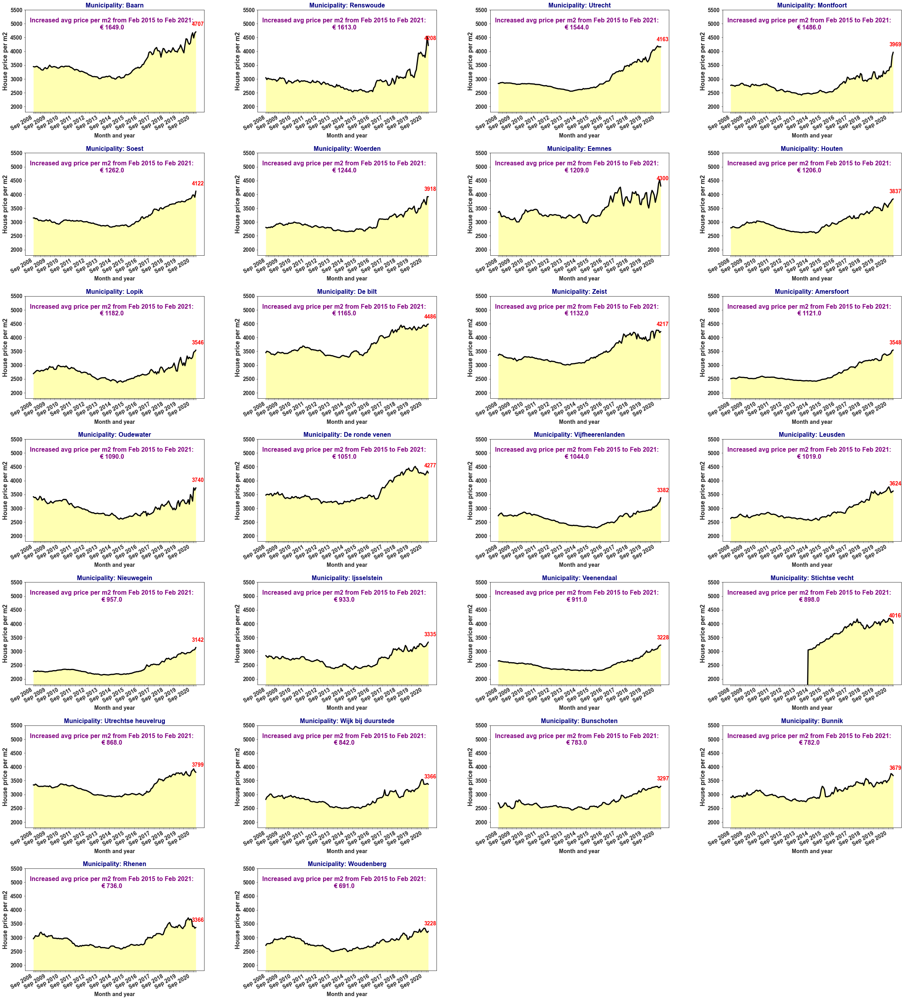

In [104]:
### Categorical Data
a = 7 # number of rows
b = 4 # number of columns
c = 1 # initialize plot counter

List_of_Municipalities = House_price_per_m2_and_increase['Municipality'].values.tolist()

fig = plt.figure()
fig.set_figheight(45)
fig.set_figwidth(40)

for Municipality in List_of_Municipalities:
    
    plt.subplot(a, b, c)
    
    plt.title('Municipality: {}'.format(Municipality.capitalize()),fontsize=16,weight='bold', color = 'navy')
    plt.xlabel('Month and year',fontsize=14, weight='bold')
    plt.ylabel('Average house price per m2',fontsize=16, weight='bold')
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.4)
    plt.xticks(rotation=30, ha='right',fontsize=14, weight='bold')
    plt.yticks(fontsize=14, weight = 'bold')
    plt.ylim(1800,5500)
    
    # Postions a label in each of the subplots indicating the house price increasing from februari 2015 to februari 2021
    Text_Price_Increase = House_price_per_m2_and_increase.loc[House_price_per_m2_and_increase['Municipality']==Municipality,'House_Price_increase_per_m2_Feb_2015_to_Feb_2021'].iloc[0]
    plt.text('Sep 2014', 4800, 'Increased avg price per m2 from Feb 2015 to Feb 2021:\n€ {}'.format(Text_Price_Increase), fontsize=16, weight = 'bold', ha = 'center', color = 'purple')
    
    Sub_dataframes = Avg_House_price_per_m2_Utrecht_df_transposed[['Month and year',Municipality]]
    df_melted = Sub_dataframes.melt('Month and year', var_name = 'Municipality', value_name = "House price per m2")
        
    LineplotFigure = sns.lineplot(y='House price per m2',x='Month and year',data=df_melted, sort = False, color = 'black', linewidth = 3)
    sns.set_style("ticks",{'axes.linewidth': 5, 'axes.edgecolor':'black'})
    
    plt.fill_between(df_melted['Month and year'].values, df_melted['House price per m2'].values, facecolor = 'yellow', alpha=0.3)
        
    for index, label in enumerate(LineplotFigure.xaxis.get_ticklabels()):
        if index % 12 != 0:
            label.set_visible(False)
    
    for LastValue in LineplotFigure.lines:
        y = LastValue.get_ydata()
        if len(y)>0:
            LineplotFigure.annotate(f'{y[-1]:.0f}', xy=(1,y[-1]+165), xycoords=('axes fraction', 'data'), 
                ha='right', va='bottom', color='red',fontsize = 14, weight = 'bold')
    
    c = c + 1
    
plt.show()

#### **Observations:**

From above line charts it is clear that a few municipalities had a steep increase in house price over the past 6 years. Among the top 10 municipalities with highest house price increase are:
* Baarn     - €1649 per m2 house price increase
* Renswoude - €1613 per m2 house price increase
* Utrecht   - €1544 per m2 house price increase
* Montfoort - €1486 per m2 house price increase
* Soest     - €1262 per m2 house price increase
* Woerden   - €1244 per m2 house price increase
* Eemnes    - €1209 per m2 house price increase
* Houten    - €1206 per m2 house price increase
* Lopik     - €1182 per m2 house price increase
* De Bilt   - €1165 per m2 house price increase

Municipality Renswoude has had a remarkable increase in house price. <br>
In just over 2 years the price increased from about €3.200 per m2 to €4.208 per m2. <br>
At the moment though the price seems to have a decreasing trend. <br>

Municipality Baarn, Utrecht, Soest, Woerden and Houten are some of the municipalites which have had a stable upward trend in house price per m2 and which are amongst the municipalities with the highest increase over the past 6 years. Investing in real estate in those municipalities could be potentially interesting based on price trends over the past years alone.

#### **Visualizing both house price and house price increase in choropleth maps**

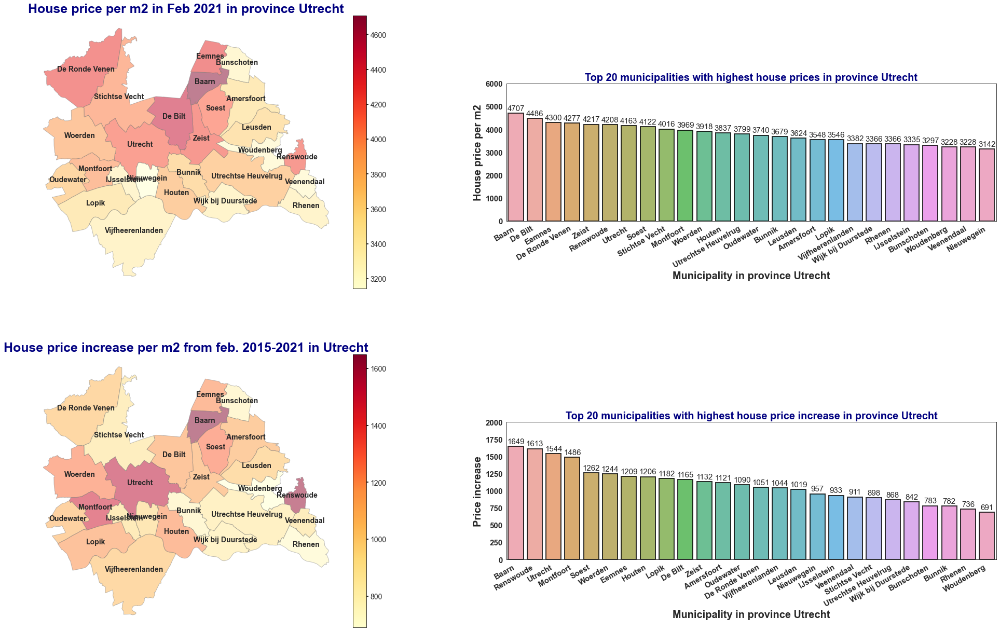

In [123]:
# Define the size of the total figure, including the Choropleth Map and 2 Bar Charts
fig = plt.figure(figsize=(40,17))

# ===================================================================================================================================================    
        
# CHOROPLETH MAP WITH HOUSE PRICE PER M2 FOR UTRECHT

# Specify the grid and and postion for the Choropleth Map
ax1 = plt.subplot2grid((10,3),(0,0), colspan = 2, rowspan = 5)

# add a title and annotation
ax1.set_title('House price per m2 in Feb 2021 in province Utrecht', fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(column='House_price_per_m2_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax1, edgecolor='.5',alpha = 0.5)

# remove the axis around the Choropleth Map
ax.axis('off')

# set to min and max of data for the colorbar
vmin = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min()
vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
for idx, row in Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.iterrows():
        plt.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')       
        
# ===================================================================================================================================================  

# BAR CHART - SHOWING THE AVERAGE HOUSE PRICE PER M2 FOR UTRECHT

# Specify the grid and and postion for the bar chart
ax2 = plt.subplot2grid((10, 3), (1, 2), colspan = 1, rowspan = 3)

# Specify the required dataframe to plot price per m2 for each municipality
df_Utr_price_2021 = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021[['Municipality','House_price_per_m2_Feb_2021']] \
.set_index('Municipality').sort_values(by=['House_price_per_m2_Feb_2021'], ascending = False)

# Create Bar Chart with for the specified dataframe
BarplotFigure2 = sns.barplot(df_Utr_price_2021.index,df_Utr_price_2021['House_price_per_m2_Feb_2021'].values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax2)

# Adding numbers on top of each bar
for p in BarplotFigure2.patches:
    BarplotFigure2.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
# Adding/formatting chart elements
ax2.set_title('Top 20 municipalities with highest house prices in province Utrecht',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax2.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax2.get_yticklabels(),fontsize = 15, fontweight = 'bold')
plt.xlabel('Municipality in province Utrecht',fontsize=20, weight = 'bold')
plt.ylabel('House price per m2',fontsize=20, weight = 'bold')
plt.ylim(0,6000)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()

# ===================================================================================================================================================    
        
# CHOROPLETH MAP WITH HOUSE PRICE INCREASE PER M2 FOR UTRECHT

# Specify the grid and and postion for the Choropleth Map
ax3 = plt.subplot2grid((10,3),(5,0), colspan = 2, rowspan = 5)

# add a title and annotation
ax3.set_title('House price increase per m2 from feb. 2015-2021 in Utrecht', fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(column='House_Price_increase_per_m2_Feb_2015_to_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax3, edgecolor='.5',alpha = 0.5)

# remove the axis around the Choropleth Map
ax.axis('off')

# set to min and max of data for the colorbar
vmin = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_Price_increase_per_m2_Feb_2015_to_Feb_2021'].min()
vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_Price_increase_per_m2_Feb_2015_to_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
for idx, row in Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.iterrows():
        plt.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')       
        
# ===================================================================================================================================================  

# BAR CHART - SHOWING THE HOUSE PRICE INCREASE PER M2 FOR UTRECHT

# Specify the grid and and postion for the bar chart
ax4 = plt.subplot2grid((10, 3), (6, 2), colspan = 1, rowspan = 3)

# Specify the required dataframe to plot price per m2 for each municipality
df_Utr_price_2021 = House_price_per_m2_and_increase[['Municipality','House_Price_increase_per_m2_Feb_2015_to_Feb_2021']] \
.set_index('Municipality').sort_values(by=['House_Price_increase_per_m2_Feb_2015_to_Feb_2021'], ascending = False)

# Create Bar Chart with for the specified dataframe
BarplotFigure2 = sns.barplot(df_Utr_price_2021.index,df_Utr_price_2021['House_Price_increase_per_m2_Feb_2015_to_Feb_2021'].values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax4)

# Adding numbers on top of each bar
for p in BarplotFigure2.patches:
    BarplotFigure2.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
# Adding/formatting chart elements
ax4.set_title('Top 20 municipalities with highest house price increase in province Utrecht',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax4.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax4.get_yticklabels(),fontsize = 15, fontweight = 'bold')
plt.xlabel('Municipality in province Utrecht',fontsize=20, weight = 'bold')
plt.ylabel('Price increase',fontsize=20, weight = 'bold')
plt.ylim(0,2000)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()

fig.tight_layout()     
    
plt.show()

#### **Observations:**
Looking at the choropleth maps, a combination of low average house price with high house price increase would be interesting. This means a lighter color in the upper choropleth and darker color in lower choropleth. By looking at the choropleths that way, then the following municipalities seem to be interesting choices:
* **Utrecht:** house prices are rather high, but return on investment seems to be good as house prices in this area have risen a lot during the past 6 years. <br>
  In fact amongst the 26 municipalities, municipality Utrecht is the third municipality with highest average house price increase over the past 6 years. 
* **Nieuwegein:** House prices in Nieuwegein are relatively low, but house prices in this area have had a stable increasing trend over the past 6 years. <br>
  The municipality is surrounded by other municipalities with higher house prices. As a result, house prices in this municipality may rise as well. <br>
  Some more research should be done to establish why house prises in this area are currently significantly lower.
* **Amersfoort:** House prices in Amersfoort are of average height and house prices have had a stable increasing trend in the past 6 years.
* **Montfoort:** House prices in Montfoort are also of average height. This municipality has very recently had a very steep price increase.

### <ins>**Part 2: Obtaining venue data using the Foursquare API and applying non-supervised machine-learning technique K-means**</ins>

In part 1, we only focused on house prices and house price increase. In part 2, we will obtain venue data and use the folium library to plot vanues on top of a choropleth map. A non-supervised machine learning technique - Kmeans - will be applied to cluster venue data based on the geospatial data available.

#### **Determining the radius around the center points of municipalities which will be applied in the Foursquare API to obtain venue information for the particular munipalities.**

When applying the Fourquare API to retrieve venue information, a radius will have to be specified around the coordinates of in this case the center points of the municipalities. In order to get an idea about what radius to choose prior to executing syntax to obtain venue information, we will plot a radius around the center points on the choropleth map to see what radius would be most suitable.

<AxesSubplot:title={'center':'Blue colored circles with 5km radius around midpoint of municipality (Black dots)'}>

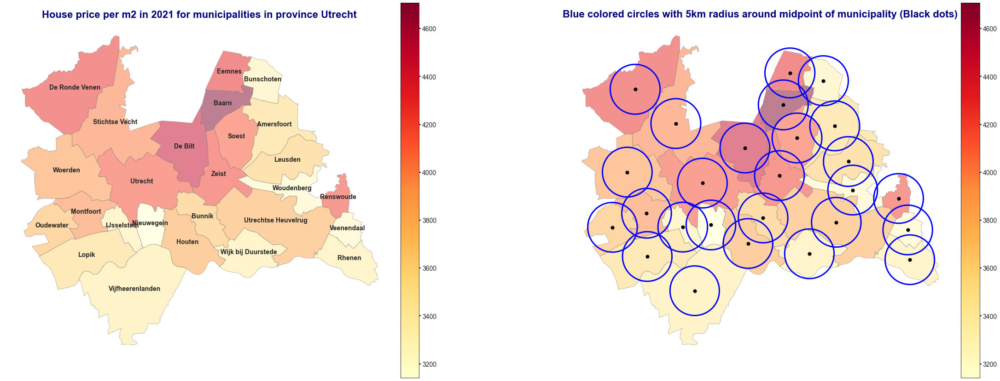

In [125]:
# Define the size of the total figure, including the Choropleth Map and 2 Bar Charts
fig, (ax1,ax2) = plt.subplots(1, 2,figsize=(40,15))

# ===================================================================================================================================================    

# CHOROPLETH MAP

# add a title and annotation
ax1.set_title('House price per m2 in 2021 for municipalities in province Utrecht', fontdict={'fontsize': '22', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(column='House_price_per_m2_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax1, edgecolor='.5',alpha = 0.5)

# remove the axis around the Choropleth Map
ax1.axis('off')

# set to min and max of data for the colorbar
vmin = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min()
vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01, ax = ax1)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
for idx, row in Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.iterrows():
        ax1.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')

# ===================================================================================================================================================    

# CHOROPLETH MAP

# add a title and annotation
ax2.set_title('Blue colored circles with 5km radius around midpoint of municipality (Black dots)', fontdict={'fontsize': '22', 'fontweight' : 'bold', 'color':'Navy'})

# create map
fig = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(cmap='YlOrRd', column='House_price_per_m2_Feb_2021', linewidth=1, ax=ax2, edgecolor='.5',alpha = 0.5)  # 

# remove the axis around the Choropleth Map
ax2.axis('off')

# set to min and max of data for the colorbar
vmin = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min()
vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = plt.colorbar(sm, orientation = "vertical", pad=0.01, ax = ax2)
cbar.ax.tick_params(labelsize=14,width=2) 

# Add location for the labels
# Geo_Coord_Municipalities_Utrecht_Merged_df['coords'] = Geo_Coord_Municipalities_Utrecht_Merged_df['geometry'].apply(lambda x: x.representative_point().coords[:])
# Geo_Coord_Municipalities_Utrecht_Merged_df['coords'] = [coords[0] for coords in Geo_Coord_Municipalities_Utrecht_Merged_df['coords']]

# Display names 
Points = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.copy()
Points = Points.set_geometry('Center_point')
Points.plot(ax=ax2,color='Black',marker = 'o',markersize=50)

Circles_df = Points.copy()
Circles_df = Circles_df.to_crs('epsg:6347')
Circles_df['Center_point'] = Circles_df['Center_point'].buffer(5000)
Circles_df = Circles_df.to_crs('epsg:4326')
Circles_df.plot(ax=ax2, color = 'None', edgecolor = 'Blue', alpha = 1, linewidth = 3)

#### **Observations:**
Because area-sizes for the municipalities seem to vary a lot, it is rather difficult to find a radius that suits all areas sizes. I have chosen a radius of 5km. With this radius, it is clear from the map on the right hand side in above picture that some areas have overlapping circles. Hence when looking for nearby venues, there will be some overlap and the same venues will be counted for multiple municipalities. It is also clear from the map that some areas do not fall within a radius and hence some venues that may exist are not part of the analysis. I have searched the internet to apply the polygons of the municipalities as the boundary for searching venues using the Foursquare API. However - I could not find a solution that worked for me and had to accept that a radius would have to be specified.

#### **Importing the required libraries for applying the Foursquare API and using the folium library to plot data on an interactive map**

In [127]:
import requests # library to handle requests
from geopy.geocoders import Nominatim

# libraries for displaying images
from IPython.display import Image
from IPython.core.display import HTML

# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize
import folium # plotting library

#### **Specifying Foursquare login details**

##### **Below cell code is hidden for privacy reasons.**

In [128]:
# @hidden_cell
CLIENT_ID = 'BOIV14ENXXHY5CICJ5PNNUKY0DLHUAYSKGGDXYVYCKDPVHBE' # your Foursquare ID
CLIENT_SECRET = 'DHGIFJZXNBWKFZT1JSEP1IKOLR3KP214SOGALQJERFABQYSP' # your Foursquare Secret
ACCESS_TOKEN = 'ISH4WNVVUK3XOHJDWWGZ30VQMA5CXYXSGZVCNTSGHT2ZPAH1' # your FourSquare Access Token
VERSION = '20180604'

#### **Creating a function for the Foursquare API to be able to retrieve the venues for each municiaplity within a 5km radius of the center of each municipality**

In [129]:
def getNearbyVenues(names, latitudes, longitudes, radius=5000, limit = 100):   # Maximum radius is 5,000m and the maximum number of venues per municipality is 100
    venues_list=[]
    
    for name, lat, lng in zip(names, latitudes, longitudes):
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            limit)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Municipality', 
                  'Municipality Latitude', 
                  'Municipality Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

#### **Using the above function to retrieve the venues for each municipality and put the result in a pandas dataframe**

In [130]:
Nearby_Venues_Municipalities_Utrecht_df = getNearbyVenues(names=Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['Municipality'],
                                          latitudes=Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['Lat'],
                                          longitudes=Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['Long']
                                          )

In [131]:
Nearby_Venues_Municipalities_Utrecht_df.head(5)

,Municipality,Municipality Latitude,Municipality Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Baarn,52.203848,5.264172,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark
1,Baarn,52.203848,5.264172,Paleis Soestdijk,52.194061,5.280125,Palace
2,Baarn,52.203848,5.264172,Kasteel Groeneveld,52.218676,5.255431,Monument / Landmark
3,Baarn,52.203848,5.264172,Hoeve Ravenstein,52.216226,5.255728,Farm
4,Baarn,52.203848,5.264172,Vuursche Bos,52.203181,5.234696,Trail


In [132]:
Nearby_Venues_Municipalities_Utrecht_df.shape

(1596, 7)

#### **Creating 3 subplots, including a choropleth map visualizing house prices and municipality names in Utrecht and 2 bar plots showing the most common venues**

<ipython-input-338-de7605a91063>:110: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.tight_layout()


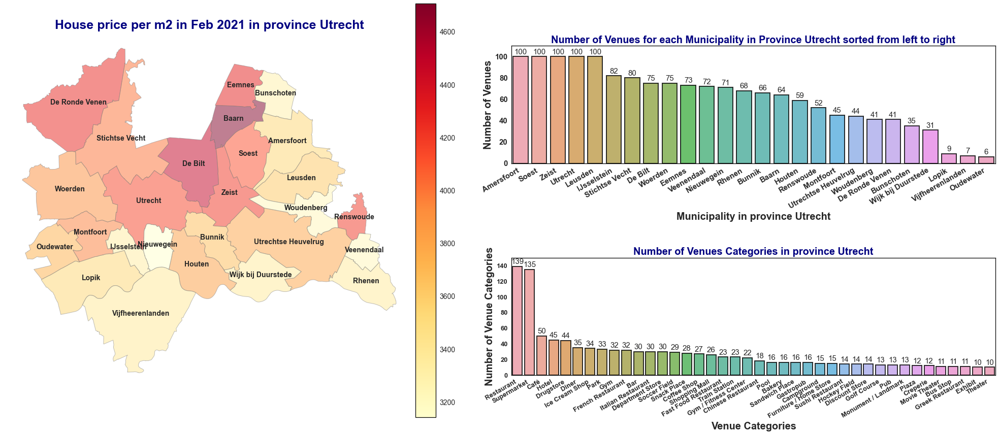

In [338]:
# Define the size of the total figure, including the Choropleth Map and 2 Bar Charts
fig = plt.figure(figsize=(35,15))

# ===================================================================================================================================================    

# CHOROPLETH MAP WITH HOUSE PRICE PER M2 FOR UTRECHT

# Specify the grid and and postion for the Choropleth Map
ax1 = plt.subplot2grid((10,10),(0,0), colspan = 5, rowspan = 10)

# add a title and annotation
ax1.set_title('House price per m2 in Feb 2021 in province Utrecht', fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

# create map
ax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.plot(column='House_price_per_m2_Feb_2021', cmap='YlOrRd', linewidth=1, ax=ax1, edgecolor='.5',alpha = 0.5)

# remove the axis around the Choropleth Map
ax.axis('off')

# set to min and max of data for the colorbar
vmin = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].min()
vmax = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord['House_price_per_m2_Feb_2021'].max()

# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

# empty array for the data range
sm.set_array([])

#add colorbar
cbar = fig.colorbar(sm, orientation = "vertical", pad=0.001)
cbar.ax.tick_params(labelsize=14,width=2) 

# Display names 
for idx, row in Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord.iterrows():
        plt.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')           
        
        
# ===================================================================================================================================================    

# BAR CHART - SHOWING THE NUMBER OF VENUES FOR EACH MUNICIPALITY IN PROVINCE UTRECHT SORTED FROM LEFT TO RIGHT

import seaborn as sns
import matplotlib.pyplot as plt

# Specify the grid and and postion for the bar chart
ax2 = plt.subplot2grid((10,10), (1,5), colspan = 5, rowspan = 3)

# Selecting column "Municipality" from the dataframe "Nearby_Venues_Municipalities_Utrecht_df" and counting amount of Venues
Counted_Categories1 = Nearby_Venues_Municipalities_Utrecht_df['Municipality'].value_counts()
Counted_Categories1 = Counted_Categories1[:40,]

# Create Bar Chart for the specified dataframe
BarplotFigure1 = sns.barplot(Counted_Categories1.index,Counted_Categories1.values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax2)

# Adding numbers on top of each bar
for p in BarplotFigure1.patches:
     BarplotFigure1.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
# Adding/formatting chart elements
ax2.set_title('Number of Venues for each Municipality in Province Utrecht sorted from left to right',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax2.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax2.get_yticklabels(),fontsize = 15, fontweight = 'bold')
plt.xlabel('Municipality in province Utrecht',fontsize=20, weight = 'bold')
plt.ylabel('Number of Venues',fontsize=20, weight = 'bold')
plt.ylim(0,110)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()

# ===================================================================================================================================================  

# BAR CHART - SHOWING THE NUMBER of venue categories FOR THE PROVINCE UTRECHT

# Selecting column "Municipality" from the dataframe "Nearby_Venues_Municipalities_Utrecht_df" and counting amount of Venues
Counted_Categories_2 = Nearby_Venues_Municipalities_Utrecht_df['Venue Category'].to_frame()
Counted_Categories_2 = Nearby_Venues_Municipalities_Utrecht_df['Venue Category'].value_counts()
Counted_Categories_2 = Counted_Categories_2[:40,]

# Specify the grid and and postion for the bar chart
ax3 = plt.subplot2grid((10, 10), (6, 5), colspan = 5, rowspan = 3)

# Create Bar Chart with for the specified dataframe

BarplotFigure2 = sns.barplot(Counted_Categories_2.index,Counted_Categories_2.values,alpha=0.8,edgecolor="black",linewidth=2, ax=ax3)

# Adding numbers on top of each bar
for p in BarplotFigure2.patches:
    BarplotFigure2.annotate(format(p.get_height(),'.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha = 'center', va = 'center', fontsize = 15,
        xytext = (0, 9),
        textcoords = 'offset points')
    
    # Adding/formatting chart elements
ax3.set_title('Number of Venues Categories in province Utrecht',fontsize = 20, weight='bold', color = 'navy')
plt.setp(ax3.get_xticklabels(),fontsize = 13, fontweight = "bold",rotation=30, ha='right')
plt.setp(ax3.get_yticklabels(),fontsize = 13, fontweight = 'bold')
plt.xlabel('Venue Categories',fontsize=20, weight = 'bold')
plt.ylabel('Number of Venue Categories',fontsize=20, weight = 'bold')
plt.ylim(0,150)
sns.set_style("white",{'axes.linewidth': 10, 'axes.edgecolor':'black'})
sns.axes_style()

plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.3) 

fig.tight_layout()   
    
plt.show()

#### **Observations:**
* For the first 5 municipalities the limit of 100 venues found by the fourquare API has been exceeded and hence the number of venues stop at 100.<br>
* Unsurprisingly, Utrecht, Soest and Zeist are on top of the list in terms of venue count. Those municipalities are in the urban part of of the province Utrecht, where average house prices are also in the higher spectrum compared to other municipalities. <br>
* Amersfoort is also a city and municiaplity in the province Utrecht. House prices in province Amersfoort are of average height (€3,548 per m2 in februari 2021), however the venue count exceeds the 100 counts.
* A similar conclusion can be drawn for the municipality Leusden, the municipality count exceeded 100, but the house prices in Leusden are relatively low (€3624 per m2). 
* Other municipalities where house prices are relatively low, but where venue count is relatively high are: Ijsselstein, Nieuwegein, Houten, Veenendaal and Rhenen.

#### <ins>**Creating bar plots showing the top 10 venue categories for each municipality by using the dataframe obtained earlier via the Foursquare API**</ins>

#### **Showing the dataframe which was created using the Foursquare API**

In [135]:
Nearby_Venues_Municipalities_Utrecht_df.head(2)

,Municipality,Municipality Latitude,Municipality Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Baarn,52.203848,5.264172,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark
1,Baarn,52.203848,5.264172,Paleis Soestdijk,52.194061,5.280125,Palace


#### **Creating a new dataframe which has columns showing the number of venue categories per municipality and total number of venues in descending order**

For each municiaplity the top 10 rows of the sorted dataframe is selected.

In [137]:
# Dataframe 1: Create new dataframe with "Municipality and "Venue Category" only. Then count the number of Venues.
df_Mun_and_Venue = Nearby_Venues_Municipalities_Utrecht_df[['Municipality','Venue Category']].copy()

# Dataframe 2: Count number of venue categories per municipality and add extra column with the counted values then sort the amount of venues per municipality in descending order
Nr_of_Venues_Per_Municipality_df = df_Mun_and_Venue.groupby(['Municipality','Venue Category']).size().to_frame('Number of Venues per Municipality').reset_index(drop = False)
Nr_of_Venues_Per_Municipality_df.sort_values(by=['Municipality','Number of Venues per Municipality'], ascending = False, inplace = True)
Nr_of_Venues_Per_Municipality_df.reset_index(drop = True, inplace = True)

# Dataframe 3: Select the top 10 rows of each municipality from the previous dataframe
Top_10_Venues_Per_Municipality = Nr_of_Venues_Per_Municipality_df.groupby(['Municipality']).head(10)

# Dataframe 4: Create new dataframe and determine the total number of venues per municipality
Tot_nr_of_venues_per_municipality_df = Top_10_Venues_Per_Municipality[['Municipality','Number of Venues per Municipality']].copy()
Tot_nr_of_venues_per_municipality_df = Tot_nr_of_venues_per_municipality_df.groupby('Municipality')['Number of Venues per Municipality'].sum().to_frame('Tot. nr of Venues per Municipality')
Tot_nr_of_venues_per_municipality_df.reset_index(drop = False, inplace = True)

# Dataframe 5: Merge "Dataframe 4" onto "Dataframe 3" in order to add total number of venues per municipality. 
# Then sort the dataframe by total number of venues per municipality, then by municipality and then by number of venues per municipality
Nr_of_Venues_Per_Municipality_df = pd.merge(Top_10_Venues_Per_Municipality, Tot_nr_of_venues_per_municipality_df, how = 'left', on = 'Municipality')
Nr_of_Venues_Per_Municipality_df.sort_values(by = ['Tot. nr of Venues per Municipality', 'Municipality', 'Number of Venues per Municipality'], ascending = False, inplace = True)
Nr_of_Venues_Per_Municipality_df.reset_index(drop = True, inplace = True)

Nr_of_Venues_Per_Municipality_df.head(22)

,Municipality,Venue Category,Number of Venues per Municipality,Tot. nr of Venues per Municipality
0,Zeist,Supermarket,11,52
1,Zeist,Restaurant,10,52
2,Zeist,Drugstore,7,52
3,Zeist,Hotel,7,52
4,Zeist,Italian Restaurant,4,52
5,Zeist,Café,3,52
6,Zeist,Chinese Restaurant,3,52
7,Zeist,Ice Cream Shop,3,52
8,Zeist,Coffee Shop,2,52
9,Zeist,Department Store,2,52


#### **Using the previous dataframe to create subplots containing bar charts that show the top 10 most common venue categories for each of the 26 municipalities in Utrecht**

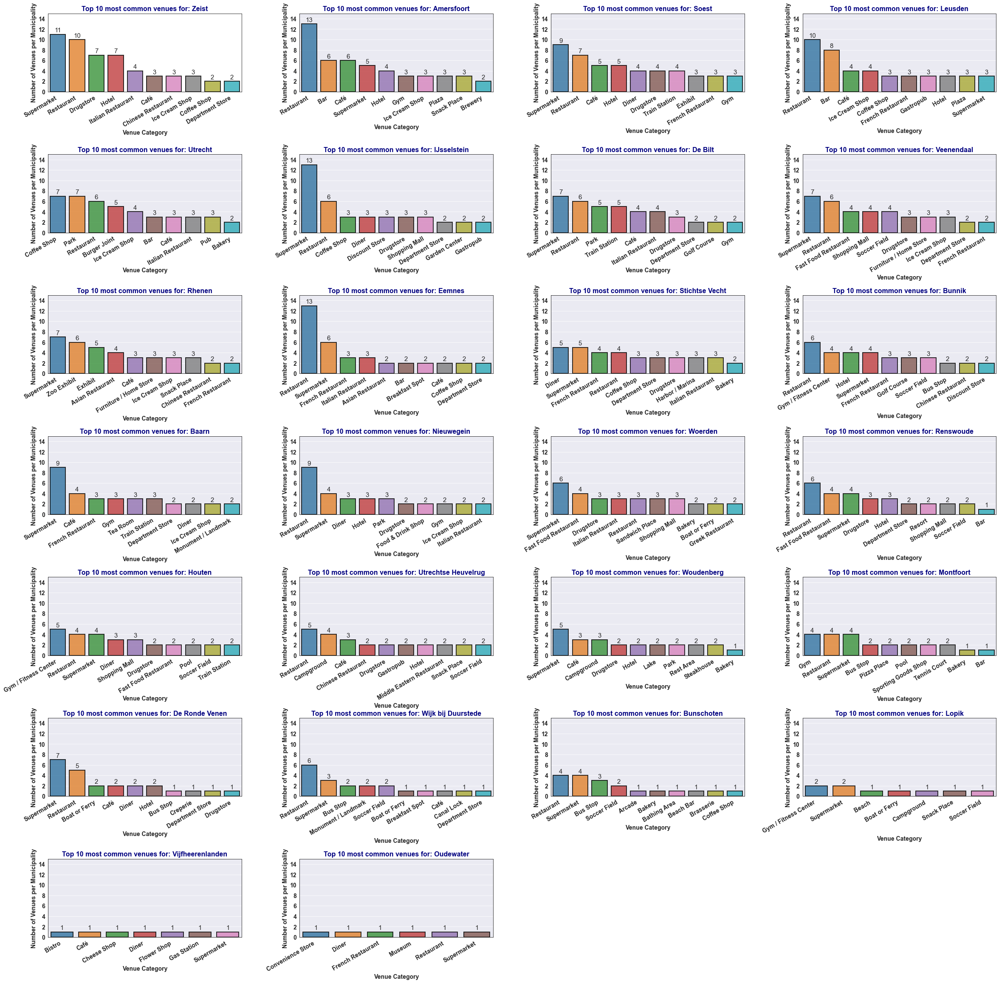

In [138]:
#  Categorical Data
a = 7  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter

List_Municipalities = Nr_of_Venues_Per_Municipality_df['Municipality'].unique().tolist()

fig = plt.figure()
fig.set_figheight(40)
fig.set_figwidth(40)

for Municipality in List_Municipalities:
    plt.subplot(a, b, c)
    plt.title('Top 10 most common venues for: {}'.format(Municipality),fontsize=16,weight='bold', color = 'navy')
    plt.xlabel('Venue Category',fontsize=14, weight='bold')
    plt.ylabel('Nr. of occurences',fontsize=14, weight='bold')
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.8)
    plt.xticks(rotation=30, ha='right',fontsize=14, weight='bold')
    plt.yticks(fontsize=14, weight = 'bold')
    plt.ylim(0,15)
    sub = Nr_of_Venues_Per_Municipality_df[Nr_of_Venues_Per_Municipality_df['Municipality'] == Municipality]
    BarplotFigure = sns.barplot(y='Number of Venues per Municipality',x='Venue Category',data=sub, alpha=0.8,edgecolor="black",linewidth=2)
    sns.set_style("darkgrid",{'axes.linewidth': 5, 'axes.edgecolor':'black'})
    for p in BarplotFigure.patches:
        BarplotFigure.annotate(format(p.get_height(), '.0f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', fontsize = 15,
                   xytext = (0, 9), 
                   textcoords = 'offset points')
    c = c + 1

plt.show()

#### <ins>**Applying "Kmeans" - an unsupervised machine learning algorithm - to split up the dataframe with venues obtained via Foursquare API into separate clusters.**</ins>

#### **Importing the required libraries for K-means**

In [146]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

#### **Showing the original dataframe that was obtained via de Foursquare API:**

In [139]:
Nearby_Venues_Municipalities_Utrecht_df.head(2)

,Municipality,Municipality Latitude,Municipality Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Baarn,52.203848,5.264172,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark
1,Baarn,52.203848,5.264172,Paleis Soestdijk,52.194061,5.280125,Palace


#### **Selecting a portion of above dataframe, from column "Venue" until column "Venue Category" and assign to a new dataframe**

In [141]:
Nearby_Venues_df = Nearby_Venues_Municipalities_Utrecht_df.loc[:,'Venue':'Venue Category']

#### **Creating a new column where the contents of the columns 'Venue','Venue Latitude' and 'Venue Longitude' are concatenated**

Here we are going to check the dataframe for duplicate values, based on 3 particular column values. <br>
The contents of the columns 'Venue', 'Venue Latitude' and 'Venue Longitude' are concatenated in a new column 'Check_duplicates_Column'. <br>
Then the column 'Check_duplicates_Column' will be used to verify whether venues have been counted multiple times due to the overlap in the chosen radius at the Foursquare API.

In [142]:
# Creating an extra column 'Check_duplicates_Column', in which column contents from 3 other columns are concatenated.
Nearby_Venues_df['Check_duplicates_Column'] = Nearby_Venues_df['Venue'].map(str) \
                                              + "-" + Nearby_Venues_df['Venue Latitude'].map(str) \
                                              + "-" + Nearby_Venues_df['Venue Longitude'].map(str)
Nearby_Venues_df.head(3)

,Venue,Venue Latitude,Venue Longitude,Venue Category,Check_duplicates_Column
0,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark,Kasteel De Hooge Vuursche-52.203667071689964-5...
1,Paleis Soestdijk,52.194061,5.280125,Palace,Paleis Soestdijk-52.19406056296845-5.280124702...
2,Kasteel Groeneveld,52.218676,5.255431,Monument / Landmark,Kasteel Groeneveld-52.218675803203354-5.255431...


#### **Count the number of duplicate values in the column "Check_duplicates_Column" in the dataframe above**

In [143]:
Nearby_Venues_df.duplicated(subset='Check_duplicates_Column', keep='first').sum()

350

350 duplicate values have been count. In the next step we will remove the duplicates.

#### **Create the dataframe that will be used for clustering later on, in which the duplicates are removed that were established in previous step**

In [144]:
Cluster_df = Nearby_Venues_df.drop_duplicates(subset = 'Check_duplicates_Column').reset_index(drop = True).drop('Check_duplicates_Column',axis=1)
Cluster_df

,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark
1,Paleis Soestdijk,52.194061,5.280125,Palace
2,Kasteel Groeneveld,52.218676,5.255431,Monument / Landmark
3,Hoeve Ravenstein,52.216226,5.255728,Farm
4,Vuursche Bos,52.203181,5.234696,Trail
...,...,...,...,...
1241,Knooppunt Lunetten,52.055450,5.144516,Intersection
1242,Busstation Lekbrug Oost,51.990818,5.082772,Bus Station
1243,De Lek,51.989969,5.083416,Beach
1244,Sushi & Meer,52.064542,5.135597,Sushi Restaurant


#### **Dropping columns that are not suitable/needed for the k-means algorithm**

In [145]:
K_Means_df = Cluster_df.drop(['Venue','Venue Category'],axis=1)
K_Means_df.head(4)

,Venue Latitude,Venue Longitude
0,52.203667,5.245899
1,52.194061,5.280125
2,52.218676,5.255431
3,52.216226,5.255728


#### **Applying the 'elbow' method to find the most suitable number for the amount of clusters "k"**

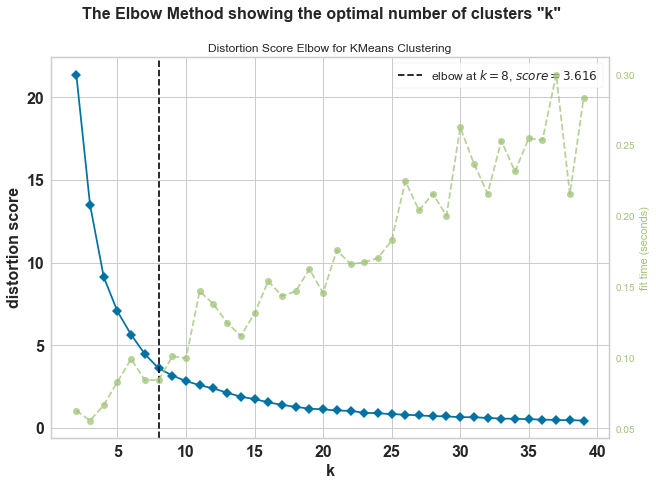

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [147]:
# !pip install yellowbrick

# Library for with different "Visualizers" that extend the scikit-learn API to allow human steering of the model selection process.
from yellowbrick.cluster import KElbowVisualizer # Import the K-means Elbow diagram visualizer 

plt.figure(figsize=(10,7))
plt.xticks(fontsize = 16, weight = 'bold')
plt.yticks(fontsize = 16, weight = 'bold')

plt.suptitle('The Elbow Method showing the optimal number of clusters "k"',fontsize = 16, weight = 'bold')
plt.xlabel('',fontsize = 16, weight = 'bold')
plt.ylabel('',fontsize = 16, weight = 'bold')

Visualizer_Elbow = KElbowVisualizer(KMeans(),k = (2,40))
Visualizer_Elbow.fit(K_Means_df)
Visualizer_Elbow.show()

#### **Applying the 'Silhouette Coefficient" method to find the optimum value for the amount of clusters "k"**

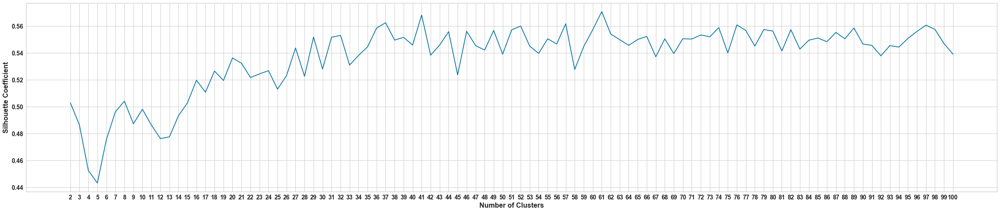

In [148]:
from sklearn.metrics import silhouette_score

sil = []
kmax = 100

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, kmax+1):
  kmeans = KMeans(n_clusters = k)
  kmeans.fit(K_Means_df)
  labels = kmeans.labels_
  sil.append(silhouette_score(K_Means_df, labels, metric = 'euclidean'))

# Plotting the distortions of K-Means, the elbow graphic
plt.figure(figsize=(40,8))
plt.plot(range(2, 101), sil)
plt.xticks(range(2, 101))
plt.xlabel("Number of Clusters", fontsize = 16, weight = 'bold')
plt.ylabel("Silhouette Coefficient", fontsize = 16, weight = 'bold')
plt.xticks(fontsize = 14, weight = 'bold')
plt.yticks(fontsize = 14, weight = 'bold')
plt.show()

#### **Using a Silhouette Diagram to determine the optimum amount of clusters "k"**

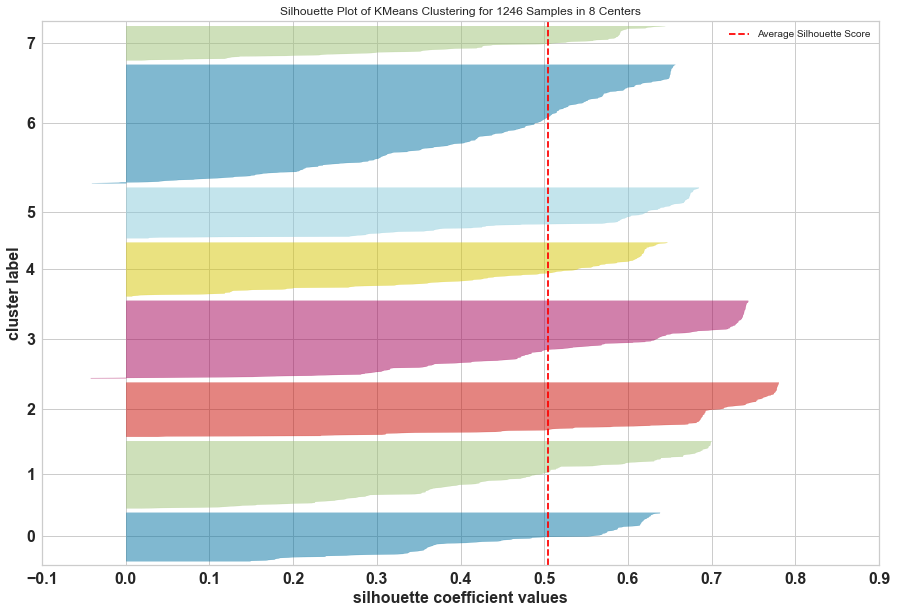

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 1246 Samples in 8 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [149]:
# !pip install yellowbrick
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer

plt.figure(figsize=(15,10))
plt.xticks(fontsize = 16, weight = 'bold')
plt.yticks(fontsize = 16, weight = 'bold')

plt.title('Silhouette Plot of KMeans Clustering',fontsize = 16, weight = 'bold')
plt.xlabel('Silhouette Coefficient Values',fontsize = 16, weight = 'bold')
plt.ylabel('Cluster Label',fontsize = 16, weight = 'bold')

Model_k = KMeans(n_clusters = 8, random_state = 44)
Visualizer_k = SilhouetteVisualizer(Model_k, colors = 'yellowbrick')
Visualizer_k.fit(K_Means_df)
Visualizer_k.show()

**Observation:**<br>
The 'elbow' location seems to be at K = 8, so we will split the dataset into 8 clusters. <br>

#### **Create an array with cluster labels using the found optimum value for "K".**

In [150]:
# Set the number of clusters
K = 8

# Run k-means clustering on the created dataframe
kmeans = KMeans(n_clusters = K,random_state=0).fit(K_Means_df)

# Check cluster labels generated for each row in the dataframe
labels = kmeans.labels_
labels

array([7, 7, 7, ..., 3, 3, 3])

#### **Insert the Cluster Labels into the dataframe "Cluster_df"**

In [151]:
# Insert the clusters in the dataframe "Utrecht_Municipalities_Grouped_Clustering"

Cluster_df2 = Cluster_df.copy()
Cluster_df2.insert(0, 'Cluster Labels', labels)

# Show dataframe including Cluster Labels
Cluster_df2 = Cluster_df2.sort_values(by=['Cluster Labels'], ascending = True).reset_index(drop = True)
Cluster_df2

,Cluster Labels,Venue,Venue Latitude,Venue Longitude,Venue Category
0,0,Ribhouse Texas,52.081564,5.421079,Steakhouse
1,0,Kruidvat,52.010260,5.431644,Drugstore
2,0,Boscafe Sandenburg,52.031625,5.369547,Café
3,0,Restaurant Landgoed Zonheuvel,52.049476,5.353740,Restaurant
4,0,Restaurant Darthuizen,52.015703,5.416660,Chinese Restaurant
...,...,...,...,...,...
1241,7,So Soest,52.158588,5.286837,Soccer Field
1242,7,MHC Soest,52.159862,5.283592,Hockey Field
1243,7,Station Hollandsche Rading,52.177642,5.178924,Train Station
1244,7,Cabrio Openluchttheater,52.154558,5.305847,Music Venue


#### **Plot the cluster labels on top of a folium choropleth map that shows the house price per m2"**

In [156]:
import folium

Folium_Map_Utrecht = folium.Map(location=[52.092777, 5.227662], zoom_start= 10)

folium.Choropleth(Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021,
            data = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord,
            key_on = 'feature.properties.Municipality',
            columns = ['Municipality','House_price_per_m2_Feb_2021'],
            fill_color = 'YlOrRd',
            fill_opacity = 0.6,
            line_opacity=0.2,
            bins = 9,
            legend_name = 'House price per m2',
            reset = True).add_to(Folium_Map_Utrecht)


import matplotlib.cm as cm
import matplotlib.colors as colors

# set color scheme for the clusters
k = Cluster_df2['Cluster Labels'].nunique()  # Amount of unique Cluster Labels
x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, Venue, Venue_Category, Cluster_Label in zip(
        Cluster_df2['Venue Latitude'], 
        Cluster_df2['Venue Longitude'], 
        Cluster_df2['Venue'], 
        Cluster_df2['Venue Category'], 
        Cluster_df2['Cluster Labels']):
    label = folium.Popup(str(Venue) + "; " +
                         str(Venue_Category) + "; " +
                         " Cluster: " + 
                         str(Cluster_Label),min_width = 200,max_width=200,parse_html=True) 
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        popup=label,
        color=rainbow[Cluster_Label-1],
        fill=True,
        fill_color=rainbow[Cluster_Label-1],
        fill_opacity=1).add_to(Folium_Map_Utrecht)

# resize image and remove white space
from branca.element import Figure
fig = Figure(width=900, height=700)
fig.add_child(Folium_Map_Utrecht)


Folium_Map_Utrecht

#### **Creating a dataframe showing the top 10 most common venues for each of the clusters**

In [157]:
# Dataframe 1: Create new dataframe with "Cluster" and "Venue Category" only. Then count the number of Venues.
Clust_and_VenueCat_df = Cluster_df2[['Cluster Labels','Venue Category']].copy()

# Dataframe 2: Count number of venue categories per cluster and add extra column with the counted values then sort the amount of venues per municipality in descending order
Nr_of_Venues_Per_Cluster_df = Clust_and_VenueCat_df.groupby(['Cluster Labels','Venue Category']).size().to_frame('Nr of Venues').reset_index(drop = False)
Nr_of_Venues_Per_Cluster_df.sort_values(by=['Cluster Labels','Nr of Venues'], ascending = [True,False], inplace = True)
Nr_of_Venues_Per_Cluster_df.reset_index(drop = True, inplace = True)

# Dataframe 3: Select the top 20 rows of each cluster from the previous dataframe
Top_10_Venues_Per_Cluster = Nr_of_Venues_Per_Cluster_df.groupby(['Cluster Labels']).head(10)

# Dataframe 4: Create new dataframe and determine the total number of venues per cluster
# Tot_nr_of_venues_per_cluster_df = Top_20_Venues_Per_Cluster[['Cluster Labels','Nr of Venues per Cluster and Venue Category']].copy()
# Tot_nr_of_venues_per_cluster_df = Tot_nr_of_venues_per_cluster_df.groupby('Cluster Labels')['Nr of Venues per Cluster and Venue Category'].sum().to_frame('Tot. nr of venues per cluster')
# Tot_nr_of_venues_per_cluster_df.reset_index(drop = False, inplace = True)

# Dataframe 5: Merge "Dataframe 4" onto "Dataframe 3" in order to add total number of venues per municipality. 
# Then sort the dataframe by total number of venues per municipality, then by municipality and then by number of venues per municipality
# Top_20_Venues_Per_Cluster = pd.merge(Top_20_Venues_Per_Cluster, Tot_nr_of_venues_per_cluster_df, how = 'left', on = 'Cluster Labels')
Top_10_Venues_Per_Cluster = Top_10_Venues_Per_Cluster.copy()
Top_10_Venues_Per_Cluster.sort_values(by = ['Cluster Labels', 'Nr of Venues'], ascending = [True,False], inplace = True)
Top_10_Venues_Per_Cluster.reset_index(drop = True, inplace = True)

Top_10_Venues_Per_Cluster.head(3)

,Cluster Labels,Venue Category,Nr of Venues
0,0,Restaurant,9
1,0,Supermarket,8
2,0,Café,4


#### **Showing the top 10 most common venues per cluster in a bar chart**

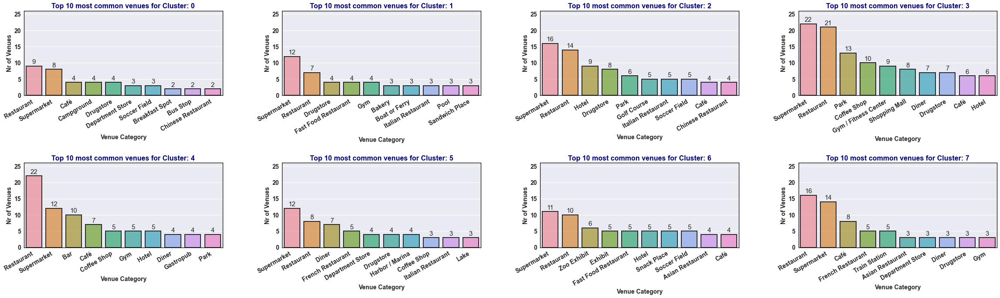

In [167]:
#  Categorical Data
a = 2  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter

List_Clusters = Top_10_Venues_Per_Cluster['Cluster Labels'].unique().tolist()

fig = plt.figure()
fig.set_figheight(10)
fig.set_figwidth(40)

for Cluster in List_Clusters:
    plt.subplot(a, b, c)
    plt.title('Top 10 most common venues for Cluster: {}'.format(Cluster),fontsize=16,weight='bold', color = 'navy')
    plt.xlabel('Venue Category',fontsize=14, weight='bold')
    plt.ylabel('Nr. of occurences',fontsize=14, weight='bold')
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.8)
    plt.xticks(rotation=30, ha='right',fontsize=14, weight='bold')
    plt.yticks(fontsize=14, weight = 'bold')
    plt.ylim(0,26)
    # plt.tight_layout()
    sub = Top_10_Venues_Per_Cluster[Top_10_Venues_Per_Cluster['Cluster Labels'] == Cluster]
    BarplotFigure = sns.barplot(y='Nr of Venues',x='Venue Category',data=sub, alpha=0.8,edgecolor="black",linewidth=2)
    sns.set_style("darkgrid",{'axes.linewidth': 5, 'axes.edgecolor':'black'})
    for p in BarplotFigure.patches:
        BarplotFigure.annotate(format(p.get_height(), '.0f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', fontsize = 15,
                   xytext = (0, 9), 
                   textcoords = 'offset points')
    c = c + 1

plt.show()

#### <ins>**Making a selection of venues related to drinking- and eating outdoor (i.e. pubs, restaurants, bars, cafes, etc) and then apply the K-means clustering method**</ins>

#### **Show the relevant dataframe with venues and coordinates that was created earlier in this notebook**

In [173]:
Cluster_df.head(2)

,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Kasteel De Hooge Vuursche,52.203667,5.245899,Monument / Landmark
1,Paleis Soestdijk,52.194061,5.280125,Palace


#### **Make a list of venues related to drinking and eating venues outdoor and use the list to select relevant venues from above dataframe**

In [174]:
List_of_Venues_Eat_or_Drink = ['Restaurant','Café','bistro','brasserie','joint','Cafetaria','Coffee','Bar','Diner','Food','Ice Cream','Pizza','Pub','Salad','Sandwich','Snack','Wine','Drink']
Nearby_Eat_and_Drink_Venues_Utrecht = Cluster_df[Cluster_df['Venue Category'].str.contains('|'.join(List_of_Venues_Eat_or_Drink))].reset_index(drop = True)
Nearby_Eat_and_Drink_Venues_Utrecht.head(5)

,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Smaecken van Hamelink,52.211656,5.291049,Ice Cream Shop
1,Restaurant Vuur,52.202181,5.247596,Restaurant
2,The Golden Coffee Box (Boot koffie),52.211594,5.288511,Coffee Shop
3,IJssalon Bemer,52.187868,5.283528,Ice Cream Shop
4,Cosa cucina & wine bar,52.211967,5.284038,Italian Restaurant


In [175]:
Nearby_Eat_and_Drink_Venues_Utrecht.shape

(452, 4)

#### **Dropping columns that are not suitable/needed for the k-means algorithm**

In [178]:
K_Means_Eat_Drink_Venues_df = Nearby_Eat_and_Drink_Venues_Utrecht.drop(['Venue','Venue Category'],axis = 1)
K_Means_Eat_Drink_Venues_df.head(3)

,Venue Latitude,Venue Longitude
0,52.211656,5.291049
1,52.202181,5.247596
2,52.211594,5.288511


#### **Applying the 'elbow' method to find the most suitable number for the amount of clusters "k"**

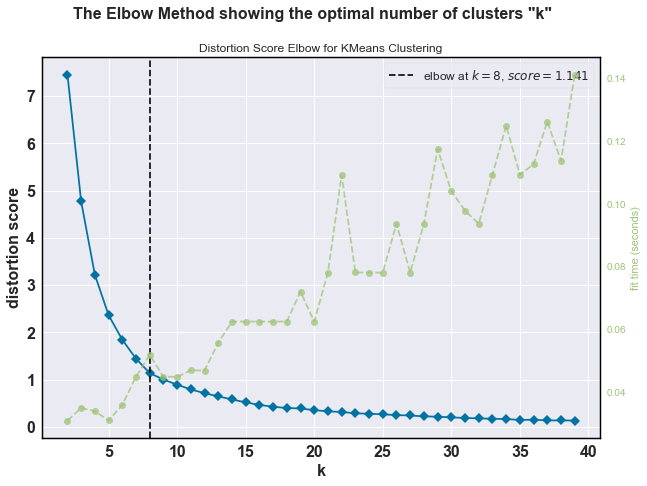

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [179]:
# !pip install yellowbrick

# Library for with different "Visualizers" that extend the scikit-learn API to allow human steering of the model selection process.
from yellowbrick.cluster import KElbowVisualizer # Import the K-means Elbow diagram visualizer 

plt.figure(figsize=(10,7))
plt.xticks(fontsize = 16, weight = 'bold')
plt.yticks(fontsize = 16, weight = 'bold')

plt.suptitle('The Elbow Method showing the optimal number of clusters "k"',fontsize = 16, weight = 'bold')
plt.xlabel('',fontsize = 16, weight = 'bold')
plt.ylabel('',fontsize = 16, weight = 'bold')

Visualizer_Elbow = KElbowVisualizer(KMeans(),k = (2,40))
Visualizer_Elbow.fit(K_Means_Eat_Drink_Venues_df)
Visualizer_Elbow.show()

#### **Create an array with cluster labels using the found optimum value for "K"**

In [180]:
# Set the number of clusters
K = 8

# Run k-means clustering on the created dataframe
kmeans = KMeans(n_clusters = K,random_state=0).fit(K_Means_Eat_Drink_Venues_df)

# Check cluster labels generated for each row in the dataframe
labels = kmeans.labels_
labels

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 3, 3,
       5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 4, 4,
       0, 4, 4, 4, 4, 0, 4, 3, 4, 4, 0, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7,
       7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6,
       6, 6, 2, 6, 1, 1, 1, 5, 3, 3, 3, 6, 6, 6, 6,

#### **Insert the Cluster Labels into the dataframe "Nearby_Eat_and_Drink_Venues_Utrecht"**

In [181]:
# Insert the clusters in the dataframe "Utrecht_Municipalities_Grouped_Clustering"
Nearby_Eat_and_Drink_Venues_Utrecht2 = Nearby_Eat_and_Drink_Venues_Utrecht.copy()
Nearby_Eat_and_Drink_Venues_Utrecht2.insert(0, 'Cluster Labels', labels)

# Show dataframe including Cluster Labels
Nearby_Eat_and_Drink_Venues_Utrecht2 = Nearby_Eat_and_Drink_Venues_Utrecht2.sort_values(by=['Cluster Labels'], ascending = True).reset_index(drop = True)
Nearby_Eat_and_Drink_Venues_Utrecht2.head(4)

,Cluster Labels,Venue,Venue Latitude,Venue Longitude,Venue Category
0,0,Smaecken van Hamelink,52.211656,5.291049,Ice Cream Shop
1,0,The Red Sun,52.273236,5.243299,Asian Restaurant
2,0,Poffertjeskraam De Haan,52.256540,5.225540,Restaurant
3,0,Moeke Spijkstra,52.272510,5.242472,Restaurant


#### **Plot the cluster labels on top of a folium chropleth map that shows the house price per m2**

In [195]:
import folium

Folium_Map_Utrecht = folium.Map(location=[52.092777, 5.227662], zoom_start= 10)

folium.Choropleth(Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021,
            data = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord,
            key_on = 'feature.properties.Municipality',
            columns = ['Municipality','House_price_per_m2_Feb_2021'],
            fill_color = 'YlOrRd',
            fill_opacity = 0.6,
            line_opacity=0.2,
            bins = 9,
            legend_name = 'House price per m2',
            reset = True).add_to(Folium_Map_Utrecht)


import matplotlib.cm as cm
import matplotlib.colors as colors

# set color scheme for the clusters
k = Nearby_Eat_and_Drink_Venues_Utrecht2['Cluster Labels'].nunique()  # Amount of unique Cluster Labels
x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, Venue, Venue_Category, Cluster_Label in zip(
        Nearby_Eat_and_Drink_Venues_Utrecht2['Venue Latitude'], 
        Nearby_Eat_and_Drink_Venues_Utrecht2['Venue Longitude'], 
        Nearby_Eat_and_Drink_Venues_Utrecht2['Venue'], 
        Nearby_Eat_and_Drink_Venues_Utrecht2['Venue Category'], 
        Nearby_Eat_and_Drink_Venues_Utrecht2['Cluster Labels']):
    label = folium.Popup(str(Venue) + "; " +
                         str(Venue_Category) + "; " +
                         " Cluster: " + 
                         str(Cluster_Label),min_width = 200,max_width=200,parse_html=True) 
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        popup=label,
        color=rainbow[Cluster_Label-1],
        fill=True,
        fill_color=rainbow[Cluster_Label-1],
        fill_opacity=1).add_to(Folium_Map_Utrecht)

# resize image and remove white space
from branca.element import Figure
fig = Figure(width=900, height=700)
fig.add_child(Folium_Map_Utrecht)


Folium_Map_Utrecht

#### **Creating a dataframe showing the top 10 most common venues for each of the clusters**

In [196]:
# Dataframe 1: Create new dataframe with "Cluster" and "Venue Category" only. Then count the number of Venues.
Clust_and_VenueCat_df2 = Nearby_Eat_and_Drink_Venues_Utrecht2[['Cluster Labels','Venue Category']].copy()

# Dataframe 2: Count number of venue categories per cluster and add extra column with the counted values then sort the amount of venues per municipality in descending order
Nr_of_Venues_Per_Cluster_df2 = Clust_and_VenueCat_df2.groupby(['Cluster Labels','Venue Category']).size().to_frame('Nr of Venues').reset_index(drop = False)
Nr_of_Venues_Per_Cluster_df2.sort_values(by=['Cluster Labels','Nr of Venues'], ascending = [True,False], inplace = True)
Nr_of_Venues_Per_Cluster_df2.reset_index(drop = True, inplace = True)

# Dataframe 3: Select the top 20 rows of each cluster from the previous dataframe
Top_10_Venues_Per_Cluster_EatDrink = Nr_of_Venues_Per_Cluster_df2.groupby(['Cluster Labels']).head(10)

# Dataframe 4: Create new dataframe and determine the total number of venues per cluster
# Tot_nr_of_venues_per_cluster_df = Top_20_Venues_Per_Cluster[['Cluster Labels','Nr of Venues per Cluster and Venue Category']].copy()
# Tot_nr_of_venues_per_cluster_df = Tot_nr_of_venues_per_cluster_df.groupby('Cluster Labels')['Nr of Venues per Cluster and Venue Category'].sum().to_frame('Tot. nr of venues per cluster')
# Tot_nr_of_venues_per_cluster_df.reset_index(drop = False, inplace = True)

# Dataframe 5: Merge "Dataframe 4" onto "Dataframe 3" in order to add total number of venues per municipality. 
# Then sort the dataframe by total number of venues per municipality, then by municipality and then by number of venues per municipality
# Top_20_Venues_Per_Cluster = pd.merge(Top_20_Venues_Per_Cluster, Tot_nr_of_venues_per_cluster_df, how = 'left', on = 'Cluster Labels')
Top_10_Venues_Per_Cluster_EatDrink = Top_10_Venues_Per_Cluster_EatDrink.copy()
Top_10_Venues_Per_Cluster_EatDrink.sort_values(by = ['Cluster Labels', 'Nr of Venues'], ascending = [True,False], inplace = True)
Top_10_Venues_Per_Cluster_EatDrink.reset_index(drop = True, inplace = True)

Top_10_Venues_Per_Cluster_EatDrink.head(3)

,Cluster Labels,Venue Category,Nr of Venues
0,0,Restaurant,15
1,0,Café,6
2,0,French Restaurant,5


#### **Showing the top 10 most common outdoor eat- and drink fascilities per cluster in a bar chart**

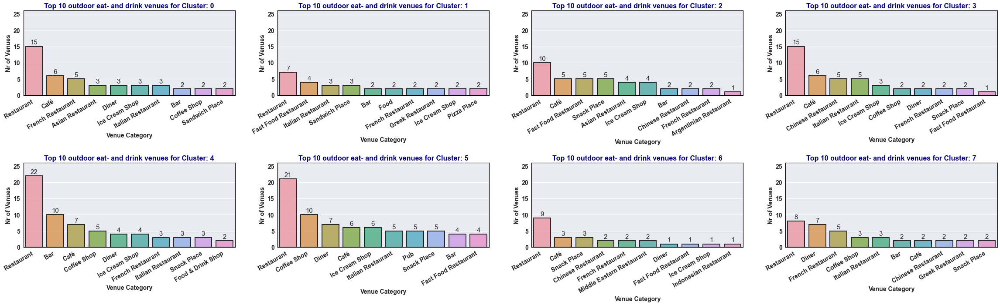

In [205]:
#  Categorical Data
a = 2  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter

List_Clusters = Top_10_Venues_Per_Cluster_EatDrink['Cluster Labels'].unique().tolist()

fig = plt.figure()
fig.set_figheight(10)
fig.set_figwidth(40)

for Cluster in List_Clusters:
    plt.subplot(a, b, c)
    plt.title('Top 10 outdoor eat- and drink venues for Cluster: {}'.format(Cluster),fontsize=16,weight='bold', color = 'navy')
    plt.xlabel('Venue Category',fontsize=14, weight='bold')
    plt.ylabel('Nr. of occurences',fontsize=14, weight='bold')
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.8)
    plt.xticks(rotation=30, ha='right',fontsize=14, weight='bold')
    plt.yticks(fontsize=14, weight = 'bold')
    plt.ylim(0,26)
    # plt.tight_layout()
    sub = Top_10_Venues_Per_Cluster_EatDrink[Top_10_Venues_Per_Cluster_EatDrink['Cluster Labels'] == Cluster]
    BarplotFigure = sns.barplot(y='Nr of Venues',x='Venue Category',data=sub, alpha=0.8,edgecolor="black",linewidth=2)
    sns.set_style("darkgrid",{'axes.linewidth': 5, 'axes.edgecolor':'black'})
    for p in BarplotFigure.patches:
        BarplotFigure.annotate(format(p.get_height(), '.0f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', fontsize = 15,
                   xytext = (0, 9), 
                   textcoords = 'offset points')
    c = c + 1

plt.show()

### <ins> **Part 3: Visualizing some other characteristics of the municiaplities, i.e. number of thefts, energy consumption, unemployment allowances, etc** </ins>

#### **Obtainning data from the website of the Dutch Central Bureau of Statistics (CBS for short), by using their API**

In [276]:
import cbsodata # CBS library to be able to retrieve data from their website, by just referring to a table number, such as '84286NED'.
District_Data = pd.DataFrame(cbsodata.get_data('84286NED', catalog_url='opendata.cbs.nl'))  # dataderden.cbs.nl    opendata.cbs.nl
District_Data.head()

,ID,WijkenEnBuurten,Gemeentenaam_1,SoortRegio_2,Codering_3,IndelingswijzigingWijkenEnBuurten_4,AantalInwoners_5,Mannen_6,Vrouwen_7,k_0Tot15Jaar_8,...,AfstandTotKinderdagverblijf_97,AfstandTotSchool_98,ScholenBinnen3Km_99,OppervlakteTotaal_100,OppervlakteLand_101,OppervlakteWater_102,MeestVoorkomendePostcode_103,Dekkingspercentage_104,MateVanStedelijkheid_105,Omgevingsadressendichtheid_106
0,0,Nederland,Nederland,Land,NL00,.,17181084,8527041,8654043,2762624,...,0.6,0.7,10.9,4154338,3367109,787228,.,NaN,2.0,1978.0
1,1,Aa en Hunze,Aa en Hunze,Gemeente,GM1680,.,25390,12666,12724,3531,...,1.1,1.2,1.8,27887,27609,279,.,NaN,5.0,279.0
2,2,Wijk 00 Annen,Aa en Hunze,Wijk,WK168000,1,3560,1735,1825,570,...,0.5,0.8,2.4,1478,1466,13,.,NaN,5.0,388.0
3,3,Annen,Aa en Hunze,Buurt,BU16800000,1,3415,1660,1755,560,...,0.5,0.7,2.4,252,252,0,9468,1.0,5.0,403.0
4,4,Verspreide huizen Annen,Aa en Hunze,Buurt,BU16800009,1,145,75,70,10,...,1.7,2.1,1.2,1226,1213,13,9468,1.0,5.0,59.0


#### **Show the column names**

In [277]:
District_Data.columns.to_list()

['ID',
 'WijkenEnBuurten',
 'Gemeentenaam_1',
 'SoortRegio_2',
 'Codering_3',
 'IndelingswijzigingWijkenEnBuurten_4',
 'AantalInwoners_5',
 'Mannen_6',
 'Vrouwen_7',
 'k_0Tot15Jaar_8',
 'k_15Tot25Jaar_9',
 'k_25Tot45Jaar_10',
 'k_45Tot65Jaar_11',
 'k_65JaarOfOuder_12',
 'Ongehuwd_13',
 'Gehuwd_14',
 'Gescheiden_15',
 'Verweduwd_16',
 'WestersTotaal_17',
 'NietWestersTotaal_18',
 'Marokko_19',
 'NederlandseAntillenEnAruba_20',
 'Suriname_21',
 'Turkije_22',
 'OverigNietWesters_23',
 'GeboorteTotaal_24',
 'GeboorteRelatief_25',
 'SterfteTotaal_26',
 'SterfteRelatief_27',
 'HuishoudensTotaal_28',
 'Eenpersoonshuishoudens_29',
 'HuishoudensZonderKinderen_30',
 'HuishoudensMetKinderen_31',
 'GemiddeldeHuishoudensgrootte_32',
 'Bevolkingsdichtheid_33',
 'Woningvoorraad_34',
 'GemiddeldeWoningwaarde_35',
 'PercentageEengezinswoning_36',
 'PercentageMeergezinswoning_37',
 'PercentageBewoond_38',
 'PercentageOnbewoond_39',
 'Koopwoningen_40',
 'HuurwoningenTotaal_41',
 'InBezitWoningcorporatie_

#### **Creating a new dataframe from above dataframe by selecting the columns of interest and renaming the columns**

In [278]:
# Selecting the columns of interest
District_Data_Selection = District_Data[['Gemeentenaam_1','SoortRegio_2','AantalInwoners_5','GemiddeldElektriciteitsverbruikTotaal_47','GemiddeldAardgasverbruikTotaal_55','GemiddeldInkomenPerInwoner_66',
                                         'HuishoudensMetEenLaagInkomen_72','PersonenPerSoortUitkeringBijstand_74','PersonenPerSoortUitkeringWW_76','TotaalDiefstalUitWoningSchuurED_78',
                                         'VernielingMisdrijfTegenOpenbareOrde_79','BedrijfsvestigingenTotaal_81']]

# Renaming the columns in the new dataframe
District_Data_Selection.columns = ('Municipality','Region_Type','Nr of inhabitants', 'Avg_Electr_Consump_kWh', 'Avg_Gas_Consump_m3', 'Avg_Income_per_inhab_x1000Euro','Prct_Households_low_income','Nr people using wellfare allowance',
                                   'Nr people unemployment allowance','Nr thefts from house or barn','Nr of cases destructive behaviour','Nr of companies and organisations')

# Showing the top 5 rows of the dataframe
District_Data_Selection.head(5)

,Municipality,Region_Type,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations
0,Nederland,Land,17181084,2790.0,1270.0,26.0,7.9,455140.0,280280.0,NaN,NaN,1573885.0
1,Aa en Hunze,Gemeente,25390,3140.0,1900.0,26.1,5.4,410.0,470.0,2.0,2.0,2230.0
2,Aa en Hunze,Wijk,3560,3130.0,1750.0,27.2,3.5,40.0,70.0,1.0,2.0,275.0
3,Aa en Hunze,Buurt,3415,3070.0,1730.0,26.4,3.4,30.0,70.0,1.0,2.0,250.0
4,Aa en Hunze,Buurt,145,4670.0,2400.0,NaN,NaN,0.0,0.0,0.0,0.0,20.0


#### **Removing any leading and trailing white space from columns where data-type is 'object' in the dataframe**

In [279]:
# Copying the above dataframe, then selecting all column types of data type 'object'
District_Data_Selection = District_Data_Selection.copy()
cols = District_Data_Selection.select_dtypes(['object']).columns

# Remove any leading and trailing white space
District_Data_Selection[cols] = District_Data_Selection[cols].apply(lambda x: x.str.strip())

# Show dataframe
District_Data_Selection.head(2)

,Municipality,Region_Type,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations
0,Nederland,Land,17181084,2790.0,1270.0,26.0,7.9,455140.0,280280.0,NaN,NaN,1573885.0
1,Aa en Hunze,Gemeente,25390,3140.0,1900.0,26.1,5.4,410.0,470.0,2.0,2.0,2230.0


#### **Creating a new dataframe by selecting rows with region type 'Gemeente' to end up with a selection of municipalities**

In [280]:
Municipality_Data_df = District_Data_Selection.copy()
Municipality_Data_df = Municipality_Data_df[Municipality_Data_df['Region_Type']=='Gemeente'].reset_index(drop = True)
Municipality_Data_df.head(2)

,Municipality,Region_Type,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations
0,Aa en Hunze,Gemeente,25390,3140.0,1900.0,26.1,5.4,410.0,470.0,2.0,2.0,2230.0
1,Aalburg,Gemeente,13153,3630.0,1680.0,24.1,4.4,130.0,150.0,1.0,2.0,1590.0


#### **Selecting the applicable rows from above dataframe by filtering on municipalities in Utrecht by using a list of municipalities in Utrecht**

In [281]:
# Create a list with all municipalities in the province Utrecht
List_Municipalities_in_Utrecht_Province = ['Amersfoort', 'Baarn', 'Bunnik', 'Bunschoten', 'De Bilt', 'De Ronde Venen', 'Eemnes', 
                                           'Houten', 'IJsselstein', 'Leerdam', 'Leusden', 'Lopik', 'Montfoort', 
                                           'Nieuwegein', 'Oudewater', 'Renswoude', 'Rhenen', 'Soest', 
                                           'Stichtse Vecht', 'Utrecht', 'Utrechtse Heuvelrug', 'Veenendaal', 
                                           'Vianen', 'Wijk bij Duurstede', 'Woerden', 'Woudenberg', 'Zederik', 'Zeist',
                                           'Leerdam', 'Vianen','Zederik']

# Use the above list to filter the dataframe for municipalities in Utrecht
Utrecht_Municipality_Data_df = Municipality_Data_df[Municipality_Data_df['Municipality'].isin(List_Municipalities_in_Utrecht_Province)].reset_index(drop = True)

# Drop the column "Region_Type"
Utrecht_Municipality_Data_df.drop('Region_Type',axis = 1,inplace = True)

# Show the dataframe
Utrecht_Municipality_Data_df.head(3)

,Municipality,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations
0,Amersfoort,155226,2740.0,1130.0,28.1,7.4,3600.0,2660.0,5.0,5.0,14315.0
1,Baarn,24630,2860.0,1570.0,31.1,5.8,400.0,360.0,8.0,4.0,3015.0
2,De Bilt,42846,3130.0,1640.0,33.0,6.3,690.0,610.0,3.0,2.0,4585.0


In [282]:
Utrecht_Municipality_Data_df.shape

(28, 11)

The amount of rows is 28. There are 26 municpalities in Utrecht. It turned out that the dataset has 3 older municipalities that became one municipality in 2019. <br>
We will merge the datasets of the 3 older municipalities into 1 dataset by calculating an average. 

#### **Verifying the presence of null values**

In [283]:
Utrecht_Municipality_Data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28 entries, 0 to 27
Data columns (total 11 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Municipality                        28 non-null     object 
 1   Nr of inhabitants                   28 non-null     int64  
 2   Avg_Electr_Consump_kWh              28 non-null     float64
 3   Avg_Gas_Consump_m3                  28 non-null     float64
 4   Avg_Income_per_inhab_x1000Euro      28 non-null     float64
 5   Prct_Households_low_income          28 non-null     float64
 6   Nr people using wellfare allowance  28 non-null     float64
 7   Nr people unemployment allowance    28 non-null     float64
 8   Nr thefts from house or barn        28 non-null     float64
 9   Nr of cases destructive behaviour   28 non-null     float64
 10  Nr of companies and organisations   28 non-null     float64
dtypes: float64(9), int64(1), object(1)
memory usage

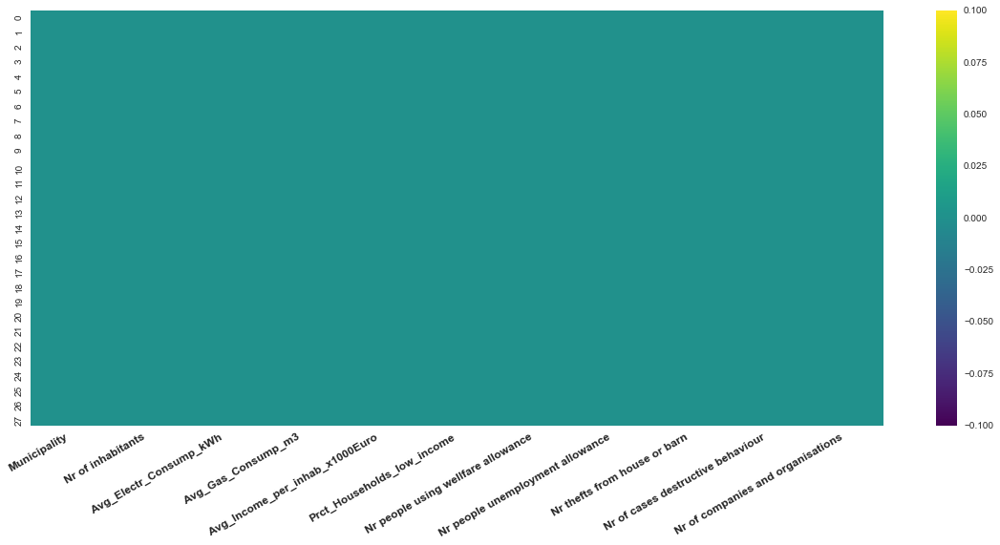

In [284]:
plt.figure(figsize=(20,8))
heatmap = sns.heatmap(Utrecht_Municipality_Data_df.isnull(),cmap='viridis')
heatmap = heatmap.set_xticklabels(heatmap.get_xticklabels(),rotation=30, ha='right',fontsize=12, weight='bold')

No null-values were found in the dataframe.

#### **Adding some column variables where absolute numbers have been turned into relative numbers**

**Let's turn the following column variables into relative variables by dividing the total amount by the amount of inhabitants in the municipality and multiplying it by 100,000:**
* Nr people using wellfare allowance
* Nr people unemployment allowance
* Nr thefts from house or barn
* Nr of cases destructive behaviour

The objective of making these column variables relative is to be able to compare the figures from different municipalities.

In [285]:
Utrecht_Munic_Data_df = Utrecht_Municipality_Data_df.copy()

Utrecht_Munic_Data_df['Nr people using wellfare allowance per 100.000 inhab'] = ( (Utrecht_Munic_Data_df['Nr people using wellfare allowance'] / Utrecht_Munic_Data_df['Nr of inhabitants']) * 100000 ).round().astype(int)
Utrecht_Munic_Data_df['Nr people unemployment allowance per 100.000 inhab.'] = ( (Utrecht_Munic_Data_df['Nr people unemployment allowance'] / Utrecht_Munic_Data_df['Nr of inhabitants']) * 100000 ).round().astype(int)
Utrecht_Munic_Data_df['Nr thefts from house or barn per 100.000 inhab.'] = ( (Utrecht_Munic_Data_df['Nr thefts from house or barn'] / Utrecht_Munic_Data_df['Nr of inhabitants']) * 100000 ).round().astype(int)
Utrecht_Munic_Data_df['Nr of cases destructive behaviour per 100.000 inhab.'] = ( (Utrecht_Munic_Data_df['Nr of cases destructive behaviour'] / Utrecht_Munic_Data_df['Nr of inhabitants']) * 100000 ).round().astype(int)

Utrecht_Munic_Data_df.head(4)

,Municipality,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations,Nr people using wellfare allowance per 100.000 inhab,Nr people unemployment allowance per 100.000 inhab.,Nr thefts from house or barn per 100.000 inhab.,Nr of cases destructive behaviour per 100.000 inhab.
0,Amersfoort,155226,2740.0,1130.0,28.1,7.4,3600.0,2660.0,5.0,5.0,14315.0,2319,1714,3,3
1,Baarn,24630,2860.0,1570.0,31.1,5.8,400.0,360.0,8.0,4.0,3015.0,1624,1462,32,16
2,De Bilt,42846,3130.0,1640.0,33.0,6.3,690.0,610.0,3.0,2.0,4585.0,1610,1424,7,5
3,Bunnik,15214,3090.0,1520.0,30.5,3.7,150.0,190.0,3.0,2.0,1670.0,986,1249,20,13


In [286]:
Utrecht_Munic_Data_df.columns

Index(['Municipality', 'Nr of inhabitants', 'Avg_Electr_Consump_kWh',
       'Avg_Gas_Consump_m3', 'Avg_Income_per_inhab_x1000Euro',
       'Prct_Households_low_income', 'Nr people using wellfare allowance',
       'Nr people unemployment allowance', 'Nr thefts from house or barn',
       'Nr of cases destructive behaviour',
       'Nr of companies and organisations',
       'Nr people using wellfare allowance per 100.000 inhab',
       'Nr people unemployment allowance per 100.000 inhab.',
       'Nr thefts from house or barn per 100.000 inhab.',
       'Nr of cases destructive behaviour per 100.000 inhab.'],
      dtype='object')

#### **Replace the 3 municipalities "Leerdam, Vianen and Zederik" by one municipality named "Vijfheerenlanden"**

As discussed before, the municipalities Leerdam, Vianen and Zederik became one municipality in 2019. <br>
In below syntax we create one row out of 3 rows, by taking the average of the 3 rows.

In [287]:
# Create new dataframe by selecting the rows of the 3 municpalities of interest.
Dataframe_LeerdamVianenZederik_df = Utrecht_Munic_Data_df[Utrecht_Munic_Data_df['Municipality'].isin(['Leerdam','Vianen','Zederik'])]

# Transpose the dataframe for handling the data
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df.set_index('Municipality').transpose()

# Add column 'Vijfheerenlanden' to the transposed dataframe and calculate average of the other 3 dataframes
Dataframe_LeerdamVianenZederik_df['Vijfheerenlanden'] = Dataframe_LeerdamVianenZederik_df[['Zederik','Vianen','Leerdam']].mean(axis=1).round(decimals=0).astype(np.int)

# Transpose the dataframe, so it is back in the original format
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df.transpose().reset_index(drop = False)

# Ensure that only the municiaplity 'Vijfheerenlanden' is selected
Dataframe_LeerdamVianenZederik_df = Dataframe_LeerdamVianenZederik_df[Dataframe_LeerdamVianenZederik_df['Municipality'].isin(['Vijfheerenlanden'])]

# Append the municipality 'Vijfheerenlanden' to the original dataframe
Utrecht_Munic_Data_df = Utrecht_Munic_Data_df.append(Dataframe_LeerdamVianenZederik_df, ignore_index = True, sort = False)

# Remove the municiaplities 'Leerdam', 'Vianen' and 'Zederik' from the original dataframe
Utrecht_Munic_Data_df.drop(Utrecht_Munic_Data_df[Utrecht_Munic_Data_df['Municipality'] == 'Leerdam'].index, inplace =True)
Utrecht_Munic_Data_df.drop(Utrecht_Munic_Data_df[Utrecht_Munic_Data_df['Municipality'] == 'Vianen'].index, inplace =True)
Utrecht_Munic_Data_df.drop(Utrecht_Munic_Data_df[Utrecht_Munic_Data_df['Municipality'] == 'Zederik'].index, inplace =True)

# Reset the index
Utrecht_Munic_Data_df.reset_index(drop = True, inplace = True)

# Show the top 4 rows of the dataframe
Utrecht_Munic_Data_df.head(4)

,Municipality,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations,Nr people using wellfare allowance per 100.000 inhab,Nr people unemployment allowance per 100.000 inhab.,Nr thefts from house or barn per 100.000 inhab.,Nr of cases destructive behaviour per 100.000 inhab.
0,Amersfoort,155226.0,2740.0,1130.0,28.1,7.4,3600.0,2660.0,5.0,5.0,14315.0,2319.0,1714.0,3.0,3.0
1,Baarn,24630.0,2860.0,1570.0,31.1,5.8,400.0,360.0,8.0,4.0,3015.0,1624.0,1462.0,32.0,16.0
2,De Bilt,42846.0,3130.0,1640.0,33.0,6.3,690.0,610.0,3.0,2.0,4585.0,1610.0,1424.0,7.0,5.0
3,Bunnik,15214.0,3090.0,1520.0,30.5,3.7,150.0,190.0,3.0,2.0,1670.0,986.0,1249.0,20.0,13.0


In [288]:
Utrecht_Munic_Data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26 entries, 0 to 25
Data columns (total 15 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Municipality                                          26 non-null     object 
 1   Nr of inhabitants                                     26 non-null     float64
 2   Avg_Electr_Consump_kWh                                26 non-null     float64
 3   Avg_Gas_Consump_m3                                    26 non-null     float64
 4   Avg_Income_per_inhab_x1000Euro                        26 non-null     float64
 5   Prct_Households_low_income                            26 non-null     float64
 6   Nr people using wellfare allowance                    26 non-null     float64
 7   Nr people unemployment allowance                      26 non-null     float64
 8   Nr thefts from house or barn                          26 non-n

It seems that we have 26 municipalities now in stead of 28, which corresponds to the amount of municipalities in Utrecht.

#### **Obtaining the geospatial data for the municiaplities from a dataframe that was created earlier in this notebook**

In [289]:
Geo_Coordinates_Municipalities = Geo_df_avg_house_price_per_m2_Utrecht_df_Feb_2021_w_coord[['Municipality','st_lengthshape','geometry','Coordinates']]
Geo_Coordinates_Municipalities.head(3)

,Municipality,st_lengthshape,geometry,Coordinates
0,Baarn,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ...","(5.264172266197837, 52.203847837423176)"
1,De Bilt,43218.826211,"POLYGON ((5.11861 52.17244, 5.11867 52.17230, ...","(5.174334940770484, 52.14173369932546)"
2,Eemnes,26271.150008,"POLYGON ((5.30619 52.27733, 5.30589 52.27728, ...","(5.279678352580331, 52.249889567210566)"


In [290]:
Geo_Coordinates_Municipalities.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 26 entries, 0 to 25
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   Municipality    26 non-null     object  
 1   st_lengthshape  26 non-null     float64 
 2   geometry        26 non-null     geometry
 3   Coordinates     26 non-null     object  
dtypes: float64(1), geometry(1), object(2)
memory usage: 960.0+ bytes


#### **Merging the dataframe with geospatial data on the dataframe with municipality details**

In [291]:
Utrecht_Munic_Data_and_Geodata_df = pd.merge(Utrecht_Munic_Data_df,Geo_Coordinates_Municipalities,how = 'left',left_on = 'Municipality', right_on = 'Municipality')
Utrecht_Munic_Data_and_Geodata_df.head(3)

,Municipality,Nr of inhabitants,Avg_Electr_Consump_kWh,Avg_Gas_Consump_m3,Avg_Income_per_inhab_x1000Euro,Prct_Households_low_income,Nr people using wellfare allowance,Nr people unemployment allowance,Nr thefts from house or barn,Nr of cases destructive behaviour,Nr of companies and organisations,Nr people using wellfare allowance per 100.000 inhab,Nr people unemployment allowance per 100.000 inhab.,Nr thefts from house or barn per 100.000 inhab.,Nr of cases destructive behaviour per 100.000 inhab.,st_lengthshape,geometry,Coordinates
0,Amersfoort,155226.0,2740.0,1130.0,28.1,7.4,3600.0,2660.0,5.0,5.0,14315.0,2319.0,1714.0,3.0,3.0,52857.726368,"POLYGON ((5.39010 52.20582, 5.38997 52.20584, ...","(5.3846896786594005, 52.173646129687704)"
1,Baarn,24630.0,2860.0,1570.0,31.1,5.8,400.0,360.0,8.0,4.0,3015.0,1624.0,1462.0,32.0,16.0,31522.964656,"POLYGON ((5.25588 52.22445, 5.25410 52.22448, ...","(5.264172266197837, 52.203847837423176)"
2,De Bilt,42846.0,3130.0,1640.0,33.0,6.3,690.0,610.0,3.0,2.0,4585.0,1610.0,1424.0,7.0,5.0,43218.826211,"POLYGON ((5.11861 52.17244, 5.11867 52.17230, ...","(5.174334940770484, 52.14173369932546)"


In [292]:
Utrecht_Munic_Data_and_Geodata_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26 entries, 0 to 25
Data columns (total 18 columns):
 #   Column                                                Non-Null Count  Dtype   
---  ------                                                --------------  -----   
 0   Municipality                                          26 non-null     object  
 1   Nr of inhabitants                                     26 non-null     float64 
 2   Avg_Electr_Consump_kWh                                26 non-null     float64 
 3   Avg_Gas_Consump_m3                                    26 non-null     float64 
 4   Avg_Income_per_inhab_x1000Euro                        26 non-null     float64 
 5   Prct_Households_low_income                            26 non-null     float64 
 6   Nr people using wellfare allowance                    26 non-null     float64 
 7   Nr people unemployment allowance                      26 non-null     float64 
 8   Nr thefts from house or barn                        

**Observation:**<br>
It turns out that the dataframe is a normal pandas dataframe. We wil convert it to a geopandas dataframe, so it can be used for making choropleth maps.

#### **Converting normal pandas dataframe to geopandas dataframe**

In [293]:
Utrecht_Munic_Data_and_Geodata_df = GeoDataFrame(Utrecht_Munic_Data_and_Geodata_df)

In [294]:
type(Utrecht_Munic_Data_and_Geodata_df)

geopandas.geodataframe.GeoDataFrame

#### **Applying the pandas 'melt()' function in order to create a dataframe where column variables are put in one column and column values into another for the purpose creating the subplot bar-charts in the following syntax**

In [295]:
ListOfValueVariables = Utrecht_Munic_Data_and_Geodata_df.loc[-1:-1,'Nr of inhabitants':'Nr of cases destructive behaviour per 100.000 inhab.'].columns.tolist()
Utrecht_Munic_Melted_df = Utrecht_Munic_Data_and_Geodata_df.melt(id_vars=['Municipality','st_lengthshape','geometry'],value_vars=ListOfValueVariables,var_name = 'Variable',value_name = 'Values').sort_values(by=['Variable','Values'], ascending = False).reset_index(drop = True) 
Utrecht_Munic_Melted_df.head(4)

,Municipality,st_lengthshape,geometry,Variable,Values
0,Utrecht,59611.274509,"POLYGON ((4.97864 52.11300, 4.97873 52.11296, ...",Prct_Households_low_income,9.8
1,Zeist,44553.501450,"POLYGON ((5.21233 52.09739, 5.21081 52.09582, ...",Prct_Households_low_income,8.2
2,Amersfoort,52857.726368,"POLYGON ((5.39010 52.20582, 5.38997 52.20584, ...",Prct_Households_low_income,7.4
3,Veenendaal,20006.774525,"POLYGON ((5.58370 52.03639, 5.58362 52.03641, ...",Prct_Households_low_income,6.8


#### **Generating subplots, thereby alternating between choropleth maps and bar charts, by looping through a the dataframe columns and rows above using a list with variables of interest**

In [ ]:
# Utrecht_Munic_Data_and_Geodata_df.to_excel("Utrecht_Munic_Data_and_Geodata_df.xlsx")

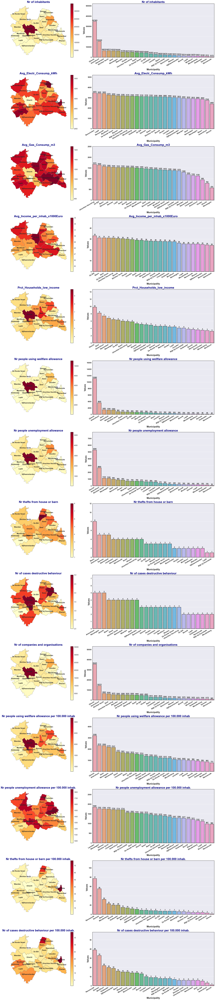

In [314]:
# Specify the number of rows and columns of the grid in which the sub-plots will be placed
a = 14 # number of rows
b = 2 # number of columns
c = 1 # initialize plot counter

# Set the figure dimensions
fig = plt.figure()
fig.set_figheight(120)
fig.set_figwidth(30)

# Create a list based on the column names that we will use to loop through
List_Columns = Utrecht_Munic_Data_and_Geodata_df.loc[-1:-1,'Nr of inhabitants':'Nr of cases destructive behaviour per 100.000 inhab.'].columns.tolist()

plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=4, hspace=0.1)

# Specify a 'for loop' for iterating through the List_Columns and create a subplot for each column in the list

for Column in List_Columns:
    
    #--------------------------------------SUBPLOTS FOR CHOROPLETH MAPS---------------------------------------------------
        ax1 = plt.subplot(a, b, c)
        
        # add a title and annotation
        ax1.set_title(Column, fontdict={'fontsize': '25', 'fontweight' : 'bold', 'color':'Navy'})

        # create map
        Utrecht_Munic_Data_and_Geodata_df.plot(column=Column,ax=ax1, cmap ='YlOrRd', linewidth=1, edgecolor='.5',alpha = 1, legend = False)

        # remove the axis around the Choropleth Map
        ax1.axis('off')

        # set to min and max of data for the colorbar
        vmin, vmax = Utrecht_Munic_Data_and_Geodata_df[Column].min(), Utrecht_Munic_Data_and_Geodata_df[Column].max()
        
        # Create colorbar legend
        sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=vmin, vmax=vmax))

        # empty array for the data range
        sm.set_array([])

        #add colorbar
        cbar = fig.colorbar(sm, orientation = "vertical", pad=0.01)
        cbar.ax.tick_params(labelsize=14,width=2) 
                
        # Display names 
        for idx, row in Utrecht_Munic_Data_and_Geodata_df.iterrows():
            ax1.annotate(text=row['Municipality'], xy=row['Coordinates'],horizontalalignment='center',fontsize=14, weight = 'bold')
    
        c = c + 1
    
     #--------------------------------------SUBPLOTS FOR SEABORN BAR CHARTS------------------------------------------------   
    
        ax2 = plt.subplot(a,b,c)
               
        ax2.set_title(Column,fontsize = 25, weight='bold', color = 'navy')
        plt.setp(ax2.get_xticklabels(),fontsize = 15, fontweight = "bold",rotation=30, ha='right')
        plt.setp(ax2.get_yticklabels(),fontsize = 15, fontweight = 'bold')
        plt.xlabel('Municipality in province Utrecht',fontsize=20, weight = 'bold')
        plt.ylabel('Amount / number',fontsize=20, weight = 'bold')
            
        
        sub = Utrecht_Munic_Melted_df[Utrecht_Munic_Melted_df['Variable'] == Column]
        BarplotFigure = sns.barplot(y='Values',x='Municipality',data=sub, alpha=0.8,edgecolor="black",linewidth=2, ax = ax2, dodge = 'False')
        plt.ylim(0,sub['Values'].max()*1.5)
        sns.set_style("darkgrid",{'axes.linewidth': 5, 'axes.edgecolor':'black'})
        sns.axes_style()
        # fig.tight_layout()
        for p in BarplotFigure.patches:
            BarplotFigure.annotate(format(p.get_height(), '.0f'), 
                       (p.get_x() + p.get_width() / 2., p.get_height()), 
                       ha = 'center', va = 'center', fontsize = 14, weight = 'bold',
                       xytext = (0, 9), 
                       textcoords = 'offset points') 
        
        plt.tight_layout()
        
        c = c + 1
    
plt.show()

## **Summary of results**

In context of the business problem, potential interesting areas to invest in real estate had to be found in the municipality of Utrecht. <br>
A couple of criteria/assumptions were given for 'potential interesting areas' by the fictional real estate agency, which are:
* House prices over the past 5 years have a stable increasing trend in the area of interest;
* Ideally the house price is currently reasonably low, but has a historical trend that indicates that house prices in that area will rise further in the future. 
* There is a variety of venues nearby, such as supermarkets, restaurants, shopping malls, etc. 
* Some additional factors that can be beneficial:
 - Low crime rates / nuisance figures;
 - Low energy consumption;
 - Low number of people using employment allowance;
 - High number of organisations nearby (employment opportunities)

Putting all the information together with above criteria in mind, the following can be concluded from the data and visualisations that were made.

##### <ins>**REQUIREMENTS 1 AND 2:**</ins>
**1. House prices over the past 5 years have a stable increasing trend in the area of interest** <br>
**2. Ideally the house price is currently reasonably low, but has a historical trend that indicates that house prices in that area will rise further in the future.**

To get answers for requirements 1 and 2, line charts and choropleth maps where created, showing the trend for house prices per m2 for each of the 26 municipalities in Utrecht. The charts also show the most recent house price value per m2 and has a note on top of the chart with the price increase over the past 6 years. Based on these graphs the following top 10 municipalities seemed to be potentially interesting areas for investing in real estate:
* Baarn
* Renswoude
* Utrecht
* Montfoort
* Soest
* Woerden
* Houten
* Amersfoort
* Leusden
* Nieuwegein

**The collection of line charts for those municipalities is shown below:**

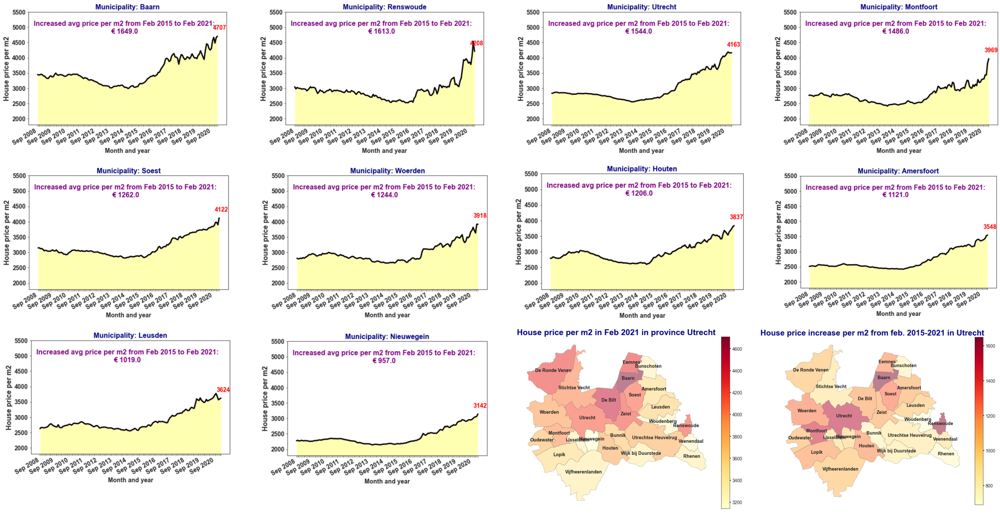

When looking at the choropleth maps, potential interesting choices could be municipalities where house prices are relatively low and increase in house prices have been high. For the above 2 choropleth maps, this means a particular municipality has a more yellowish colour on the left choropleth map and a more orange/reddish colour on the right choropleth map. The following municipalities would then be interesting areas:
* Montfoort
* Ijsselstein
* Nieuwegein
* Amersfoort
* Woerden

The above mentioned municipalities seem to have low- to average house prices and have had a stable increase in house price per m2 over the past few years.

##### <ins>**REQUIREMENT 3:**</ins>
**3. There is a variety of venues nearby, such as supermarkets, restaurants, shopping malls, etc.**

By using the Foursquare API we obtained location data from venues within a 5km radius from the center point of each municipality. The K-means algorithm was applied on the coordinates of the venues and clusters were formed based on how near the venues were to each other. The most suitable amount of clusters 'k' was found to be 8, which was established using the 'elbow' method that plots a distortion score against the amount of klusters 'k'. After clusters were created by the K-means algorithm, the array of clusters was included in the dataframe with venue names. Then a choropleth map was made using the 'folium library'. The map shows the average house prices per m2 per municipality. The venues were plotted on top of the choropleth map by markers (dots). Clusters were visualized by varying color of the markers. Bar charts were created for each cluster, showing the top 10 most common venues in the cluster in descending order. The result is shown below.

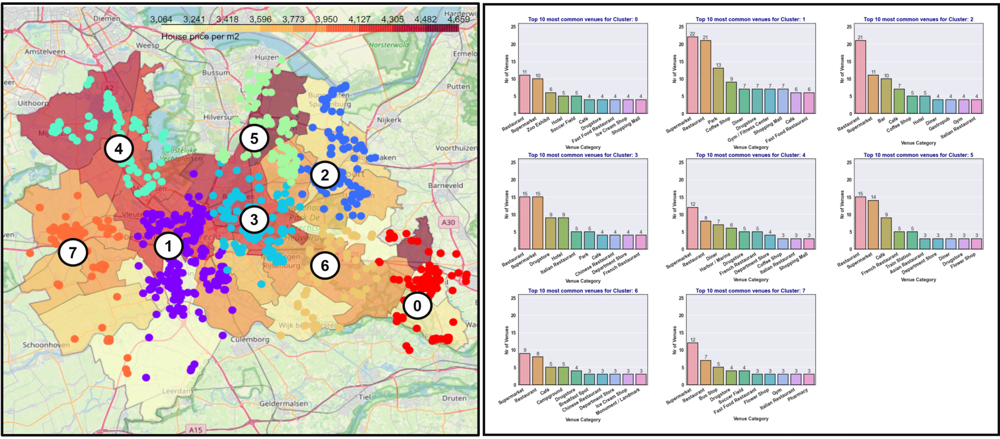

Overall there seems to be multiple clusters and sub areas in those cluster where it could be interesting to invest in real-estate with the aim of reselling it for a higher price. Cluster 1, 3, 4 and 5 are in the highest house price range and have a high degree of urbanity, with dense areas of venues being closely packed together. Around those clusters there are some areas that also have a high venue count and density, but where house prices are lower, which is the 'south part of cluster 1' and 'cluster 2'. Assuming that we aim for areas with low house prices and potential high profit in the future, then the south part of cluster 1 and cluster 2 would be interesting areas to examine further. <br>

The interesting areas are circled in black below:

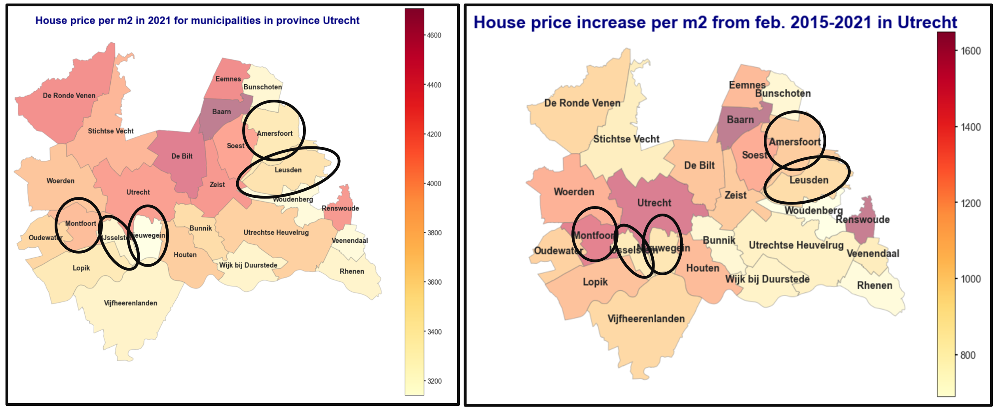

The current situation in the Netherlands (March 2021) is that there is a great shortage of house offerings on the market. House prices have risen so much that young people cannot get a mortgage to purchase their first house. Waiting for a period until house prices reduce, which can take a while, is often not a choice that young couples that want to settle and start a family are willing to take. An increasing number of people therefore look for places a little further away from the main city, where house prices are a little lower. There is currently also a trend ongoing of older people who move away from the city centers to purchase a larger free-standing-house in more remote, cheaper areas to enjoy nature and the peaceful landscape outside the city. As demand for accomodations outside the city increase, house prices outside the city will also increase. Considering this, the above encircled areas that are a little outside the main city of Utrecht are therefore likely to yield good profit when investing and reselling houses in those areas.

##### <ins>**ADDITIONAL FACTORS THAT CAN BE INTERESTING WHEN SELECTING POTENTIAL AREAS FOR INVESTING IN PROPERTY:**</ins>
 * **Low crime rates / nuisance figures;**
 * **Low energie consumption;**
 * **Low number of people using unemployment allowance;**
 * **High number of organisations nearby (employment opportunities)**

Data related to above 4 mentioned themes were obtained via API and the library 'cbsodata' from the Dutch Bureau of Statistics. A collection of subplots was generated, where choropleth maps and complementary bar charts where shown. These charts can be found at the end of previous section, just above the heading "Summary of results" of this section. Some interesting findings/insights gained from the choropleth maps and bar charts are:
* The muncipality Utrecht has by far the most inhabitants (347,483 in the chart) and has more than twice the amount of inhabitans compared to the second largest city Amersfoort (155,226 inhabitans). The third municipality with most inhabitans is Veenendaal having 64,918 inhabitants, which is significantly lower compared to Utrecht and Amersfoort.
* Both the average electricity and average gas consumption in the municipalities Utrecht and Amersfoort are less compared to the other municipalities in the province. I found an article on the internet that claimed that the cause of the lower energy consumption is that the main cities have a lot more apartments than free-standing-houses. Heat loss and living areas in the apartments are less compared to free-standing houses and hence the larger amount of apartments in main cities result in a lower average for energy consumption. Another factor for lower energy consumption in main cities is the presence of district heating. Households that use district heating commonly do not consume any gas. 
* Average income seems to be higher in some higher-priced municipalities near the cities Utrecht and Amersfoort and municipalties between Utrecht and Amsterdam. The top 10 municipalities with highest average income are: De Bilt, Baarn, Zeist, De Ronde Venen, Utrechtse Heuvelrug, Bunnik, Stichtse Vecht, Houten, Leusden and Soest. When looking at the choropleth maps, we see that house prices for most of the mentioned municipalities are in the higher spectrum (orange to redish color). Exceptions are the municipalties Leusden and Utrechtse Heuvelrug, where house prices are in the lower- to average spectrum (yellow- to light orange on the map), but where average income seems to be higher.
* Contrary to what might be expected, the percentage of households with low income seems to be higher in cities with higher average house prices. The top 10 cities with the highest percentage of households with a low income as indicated by the CBS are: Utrecht, Zeist, Amersfoort, Veenendaal, Nieuwegein, De Bilt, Soest, Utrechtse Heuvelrug, Baarn and Rhenen. 
* The relative number of people using financial governmental support (welfare allowance, unemployment allowance) seem to be high for municipalities in the vicinity of main cities, such as Utrecht and Amersfoort. Also in areas around Utrecht there seem to be areas where the relative number of people using financial support is high. There is not really a clear area where there are multiple municipalities that have a lower relative number of people using unemployment allowances. When looking at absolute numbers, then Utrecht and Amersfoort have most people using unemployment allowances, but these municipalities have a lot more inhabitants than the other municipalities and therefore the comparison to other municipalties using absolute numbers would not be meaningful. 
* For the relative number of thefts and registered cases of destructive behaviour of people per municipality, some areas seem to be more popular, which are: Renswoude, Eemnes, Baarn, Woudenberg, Bunnik and Oudewater. In Renswoude, Eemnes and Baarn the house prices per m2 are relatively high. Apparently some people in the theft-business seem to be aware of peoples wealth in those areas. However – looking at the total number of thefts we see that the amount is relatively small.
* The top 10 number of municipalities with highest number of companies/organisation are: Utrecht, Amersfoort, Stichtse Vecht, Zeist, Utrechtse Heuvelrug, Woerden, Veenendaal, De Ronde Venen, Nieuwegein, Soest. Areas close to potential jobs tend to be more in demand than places that are more remote and require more travel time to the work location.

Having looked at above additonal information, the following can be said:
* Looking at the number of people living in each municipality, we can see that Utrecht and Amersfoort are by far the most popular areas to live. 
* The fact that average incomes are higher in and near the cities is meaningful to know, but is not very surprising as living in cities is more expensive and there are more jobs available. The fact that in Leusden average house price is relatively low, but average income is relatively high is interesting. People that can spend more money on their home could drive up the house prices in that area.
* When looking at the absolute (total) numbers for theft and registered cases for destructive behaviour by people, the numbers are very low compared to the number of inhabitans in each municipality.
* Unsurprisingly most registered companies/organisations are found in the municipalities Utrecht and Amersfoort, which are also the two main cities in province Utrecht. Living in or near those areas can be beneficial in terms of employment opportunities, which attract potential house buyers.

## **Discussion section**

In the previous section, the findings from the choropleth maps and bar charts in the methodology section were discussed. <br>
In this section we will discuss the observations that were made and recommendations that can be made.

The assignment was to search for potential interesting areas within the province Utrecht to invest in real estate on the residential house market. 
A couple of preconditions were given by the fictional real estate investment organisation to refine the search for interesting areas, which were:
* House prices over the past 5 years have a stable increasing trend in the area of interest;
* Ideally the house price is currently reasonably low, but has a historical trend that indicates that house prices in that area will rise further in the comming future.
* There is a variety of venues nearby, such as supermarkets, restaurants, shopping malls, etc.

Having taken the above criteria into consideration, the following municipalities were selected as potentially interesting areas to purchase and resell properties:
* Amersfoort
* Leusden
* Nieuwegein
* Ijsselstein
* Woerden

The above selected municipalities have low- to average house prices, venues are clustered relatively close together and venue count and variety is relatively high, also house prices in these areas have had a stable increasing trend over the past few years and these municipalities are in or near the main cities Utrecht and Amersfoort, where house prices are high. <br>

I should note that my area of expertise is not in real estate and in reality the best choice may simply be to purchase and resell properties in the areas where demand for accomodations is highest and that the magnitude of the house price does not play a role. Therefore I deliberatly specified some preconditions at the beginning of this assignment that seemed logical criteria when looking for interesting areas to invest in property. From some news articles that I read, I knew that in the currrent situation of the Dutch house market, there is a great shortage of houses, which is driving up the house prices further. A lot of people that want to purchase their first house are not eligible for a mortgage because their income does not match the needed loan they would need to purchase the house. As a result there is an increasing trend of people looking for cheaper houses outside the cities, but still relatively close to the city areas. There is also a trend going on of older people that choose to leave the city area to purchase larger free-standing houses in more remote areas. The corona crisis may speed up these trends as well. As more people have started working from home during the corona crisis, companies were forced to ensure that the required technologies that allow people to work at home were in place. During and after the crisis this may change the way we work permanently and the need to be near a city center may become less as well, because people can work remotely. As a result, demand for houses outside the city may rise, which in turn would drive up the house prices outside the city. 

By taking these developments into consideration it seems to be a good choise to look for places near the cities where house prices are still relatively low, where there is a variety of venues near each other and where there has been a stable upward trend in house prices. The 5 selected municipalties met the specified criteria. Therefore my recommendation to the real estate agency would be to focus on those municipalities to purchase and resell property with the aim of making a profit. 

A challenge I faced when making this report was with applying the K-means algorithm. Initially I had put different information together in a dataframe, including variables with information about neighourhoods, such as crime rates, average income, distance to large supermarkets, distances to restaurants, distances to cafes, etc. After normalizing the data and applying the k-means algorithm clusters were formed. However - after studying the clusters I found that almost all the data points were appointed to one particular cluster and only a few to 2 clusters. A lot of the variables had outliers in the data and that could have affected the outcome of the k-means algorithm. After working on the dataset for a while and looking for manners to yield a more plausible separation into clusters, I chose to only use the coordinates of the venues to apply the k-means clustering algorithm. The elbow method helped to select the most suitable number for the amount of clusters 'k'. However when plotting the data on the choropleth map using the folium library, I thought that the the dataset could be split up in more clusters. Therefore I also applied the Silhouette Coefficient method and drew a Silhouette Diagram to examine if another value for the amount of clusters may be better. I found that the highest Coefficient was at k = 41, so 41 clusters. However - when applying the Coefficient Method the the number for the ideal amount of clusters changed in the Silhouette Method. Therefore I was not convinced that k = 41 was a reliable number for choosing the ideal amount of clusters. Eventually I chose the amount of clusters to be 8, because that was the amount of clusters that the elbow method indicated to be the ideal amount of clusters and this also corresponded to the first peak in the line-chart for the Silhouette Coefficient. 

I obviously still have a lot to learn about programming in Python and about algorithms that are used in data science, when those are useful and how to feed those models with the right (preprocessed) data that can be turned into usefull information. However - the journey of discovering the fundamentals of data science, learning the basics of programming in Python and coming up with a self-chosen challenge was interesting. Especially during the last assignment I have learned a lot, as I searched the internet to apply certain techniques/syntax in Python in order to process data or turn data into a certain table or graphic. Hopefully - the things I learned in this course will form a good basis for further developing my knowledge and skills in analyzing data and applying data science techniques. 

## **Conclusions**

The objective was to find specific areas in Utrecht that would be interesting to invest in houses with the aim of celling and reselling those to make a profit. Data from different sources and in different forms were gathered from the internet using different python libraries, such as Pandas, Geopandas, Foursquare API and the API from the Dutch Central Bureau of Statistics using the library 'cbsodata'. Data was examined, pre-processed and merged together to form dataframes that could be used to make choropleth maps with geopandas and folium and to create line charts and bar plots that gave us the required information to draw conclusions about potential interesting investment areas, thereby taking into account a few preconditions set by the real estate investment agency. Eventually, 5 of the 26 municipalities met the criteria, which were **Amersfoort, Leusden, Nieuwegein, Ijsselstein, Woerden**. For these municipalties, house price trends have had a relatively stable increasing trend over the past few years. Besides that currently the average house prices are relatively low in these municipalities. There is also a variety of venues at or near these municipalities and all municipalities are in or near larger cities, which seem to become more popular places, especially to people that purchase their first house.